In [1]:
import pickle, os
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
from bokeh.io import output_file, show
from bokeh.models import HoverTool
from bokeh.plotting import figure
from bokeh.util.hex import hexbin
from sklearn.preprocessing import StandardScaler
from skimage.transform import resize
import holoviews as hv
from holoviews import opts
import holoviews as hv
from holoviews.operation import histogram


Bad key text.latex.unicode in file C:\Users\Harrison\Anaconda3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle, line 112 ('text.latex.unicode : False # use "ucs" and "inputenc" LaTeX packages for handling')
You probably need to get an updated matplotlibrc file from
https://github.com/matplotlib/matplotlib/blob/v3.3.2/matplotlibrc.template
or from the matplotlib source distribution

Bad key savefig.frameon in file C:\Users\Harrison\Anaconda3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle, line 423 ('savefig.frameon : True')
You probably need to get an updated matplotlibrc file from
https://github.com/matplotlib/matplotlib/blob/v3.3.2/matplotlibrc.template
or from the matplotlib source distribution

Bad key pgf.debug in file C:\Users\Harrison\Anaconda3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle, line 444 ('pgf.debug           : False')
You probably need to get an updated matplotlibrc file from
https://github.com/mat

In [2]:
def normalize(df):
    result = df.copy()
    for feature_name in df.columns: 
        max_value = df[feature_name].max()
        min_value = df[feature_name].min()
        result[feature_name] = (df[feature_name] - min_value) / (max_value - min_value)
    return result

In [3]:
d = r'C:\Users\Harrison\Desktop\annotations\old'
old_data = []
types = []
samples = []
stains = []
dd = None
for subd in os.listdir(d):
    for f in os.listdir(os.path.join(d, subd)):
        if 'multi' in f:
            print('skipped', f)
        else:
            old_data.append(np.load(open(os.path.join(d, subd, f), 'rb')))
            if '_neg' in subd:
                stains.append(subd.split('_neg')[0])
                types.append('Negative')
            elif '_pos' in subd:
                stains.append(subd.split('_pos')[0])
                types.append('Positive')
    #         print(subd.split('_neg')[0])
            if f.split('-')[0] == '': 
                samples.append('66')
            else:
                samples.append(f.split('.czi')[0])


skipped multi-34-10-an.czi0.npy
skipped multi-34-10-an.czi1.npy
skipped multi-34-10-an.czi2.npy
skipped multi-34-10-an.czi3.npy
skipped multi-34-10-an.czi4.npy
skipped multi-34-10-an.czi5.npy
skipped multi-34-10-an.czi6.npy
skipped multi-34-10-an.czi7.npy
skipped multi-34-10-an.czi8.npy
skipped multi-34-9-an.czi0.npy
skipped multi-36-9-an.czi0.npy
skipped multi-36-9-an.czi1.npy
skipped multi-36-9-an.czi2.npy
skipped multi-36-9-an.czi3.npy
skipped multi-37-10--an.czi0.npy
skipped multi-37-9-an-nocells.czi0.npy
skipped multi-38-10-an.czi0.npy
skipped multi-38-10-an.czi1.npy
skipped multi-38-10-an.czi10.npy
skipped multi-38-10-an.czi2.npy
skipped multi-38-10-an.czi3.npy
skipped multi-38-10-an.czi4.npy
skipped multi-38-10-an.czi5.npy
skipped multi-38-10-an.czi6.npy
skipped multi-38-10-an.czi7.npy
skipped multi-38-10-an.czi8.npy
skipped multi-38-10-an.czi9.npy
skipped multi-38-9-an.czi0.npy
skipped multi-38-9-an.czi1.npy
skipped multi-38-9-an.czi2.npy


In [4]:
df_old = pd.DataFrame()
df_old['size'] = [np.sqrt(d.shape[0]*2 * d.shape[1]*2) for d in old_data]
df_old['BF Intensity'] = [np.mean(d[...,0]) for d in old_data]
df_old['DAPI Intensity'] = [np.mean(d[...,1]) for d in old_data]
df_old['555 Intensity'] = [np.mean(d[...,2]) for d in old_data]
df_old['647 Intensity'] = [np.mean(d[...,3]) for d in old_data]
df_old = normalize(df_old)
df_old['type'] = types
df_old['sample'] = samples
df_old['stain'] = stains
df_old

C:\Users\Harrison\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
C:\Users\Harrison\Anaconda3\lib\site-packages\numpy\core\_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


,size,BF Intensity,DAPI Intensity,555 Intensity,647 Intensity,type,sample,stain
0,0.078788,0.728696,0.037159,0.044298,0.021681,Negative,410al-2,fetal_555_fetal_647
1,0.052529,0.674459,0.009022,0.018623,0.076934,Negative,410al-2,fetal_555_fetal_647
2,0.061769,0.664366,0.007909,0.019765,0.037966,Negative,410al-2,fetal_555_fetal_647
3,0.050434,0.676508,0.008176,0.018533,0.024073,Negative,410al-2,fetal_555_fetal_647
4,0.055234,0.707598,0.007769,0.018528,0.022370,Negative,410al-2,fetal_555_fetal_647
...,...,...,...,...,...,...,...,...
1816,0.073930,0.704110,0.135014,0.889362,0.156883,Positive,975-8-an,fetal_647_maternal_555
1817,0.151751,0.697166,0.053847,0.414555,0.125899,Positive,975-8-an,fetal_647_maternal_555
1818,0.093385,0.674814,0.058161,0.510782,0.173257,Positive,975-8-an,fetal_647_maternal_555
1819,0.108949,0.713778,0.076118,0.622993,0.074589,Positive,975-8-an,fetal_647_maternal_555


In [5]:
df_old['stain'].unique()

array(['fetal_555_fetal_647', 'fetal_555_maternal_647_cvs',
       'fetal_555_maternal_647', 'fetal_647_maternal_555'], dtype=object)

In [6]:
d = r'C:\Users\Harrison\Desktop\annotations\new'
new_data = []
for f in os.listdir(d):
    data_p = (pickle.load(open(os.path.join(d,f), 'rb')))      
    for dd in data_p:
        dd = list(dd)
        dd.append(f.split('-annotated')[0])
        new_data.append(dd)
new_data = np.delete(new_data, 87)
new_data = np.delete(new_data, 446)
new_data = np.delete(new_data, 446)

C:\Users\Harrison\Anaconda3\lib\site-packages\numpy\core\_asarray.py:83: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order)


In [7]:
y_train = np.zeros(len(new_data))
x_train = np.zeros((len(new_data),196, 196, 4), dtype=np.uint16)
all_channels = ['Alex488', 'Alexa647', 'DAPI', 'Default', 'tritc']

translation_dict ={'Positive': 1, 'Negative': 0}
# prepare data for autoencoder
len(new_data)
cleaned_data = []

# remove samples we do not want
for i, sample in enumerate(new_data):    
    if '78-w' not in sample[-1] and 'w2(647no488)' not in sample[-1] and 'w2(488no647)' not in sample[-1] and '112-w4' not in sample[-1]: 
        cleaned_data.append(sample)
#         print(sample[1])

# get one group of samples with same channels
def get_group(channel_list, data):
    group = []
    for sample in data:
        if sample[1] == channel_list:
            group.append(sample)
    return group

def get_sizes(group):
    sizes = []
    for sample in group:
        sizes.append(np.sqrt(sample[2].shape[0] * sample[2].shape[0]))

l1 = ['Alexa647', 'DAPI', 'Default', 'tritc']
gr1 = get_group(l1, cleaned_data)

l2 = ['Alex488', 'Alexa647', 'DAPI', 'Default']
gr2 = get_group(l2, cleaned_data)

l3 = ['Alex488', 'Alexa647', 'DAPI', 'Default', 'tritc']
gr3 = get_group(l3, cleaned_data)


gr1_names = set([sample[-1] for sample in gr1])
gr2_names = set([sample[-1] for sample in gr2])
gr3_names = set([sample[-1] for sample in gr3])

print(gr1_names,'\n', len(gr1))
print(gr2_names,'\n', len(gr2))
print(gr3_names,'\n', len(gr3))

{'58-w7-4', '57-w8', '58-w8-neg', '63-w5-2', '63-w7', '58-w3-125453', '58-w8', '58-w7-neg', '57-w4-4', '63-w3-132420', '58-w1', '58-w2', '58-w7-neg2', '58-w7-2', '57-w4-2'} 
 154
{'68-w8', '68-w3', '68-w3-2', '68-final-4', '68-w5', '68-final-2', '68-final-5', '69-w7', '68-final-6'} 
 166
{'66-w4', '66-w7', '66-w5', '66-w3'} 
 19


In [9]:
scale = False
DIM = 128

# create training set for group 1
x_train1 = np.zeros((len(gr1), DIM, DIM, 3))
y_train1 = np.zeros(len(gr1))
for i, sample in enumerate(gr1):
    # get them from our known channel indexes
    a647 = sample[2][..., 0]
    dapi = sample[2][..., 1]
    bf = sample[2][..., 2]
    # place them in consistent order
    if scale:
        scaler = StandardScaler()
        x_train1[i,...,0] = scaler.fit_transform(resize(a647, (DIM, DIM)))
        scaler = StandardScaler()
        x_train1[i,...,1] = scaler.fit_transform(resize(dapi, (DIM, DIM)))
        scaler = StandardScaler()
        x_train1[i,...,2] = scaler.fit_transform(resize(bf, (DIM, DIM)))
    else:
        x_train1[i,...,0] = resize(a647, (DIM, DIM))
        x_train1[i,...,1] = resize(dapi, (DIM, DIM))
        x_train1[i,...,2] = resize(bf, (DIM, DIM))
    y_train1[i] = translation_dict[sample[0]]
print(np.sum(y_train1)/len(y_train1))    


# create training set for group 2
x_train2 = np.zeros((len(gr2), DIM, DIM, 3))
y_train2 = np.zeros(len(gr2))
for i, sample in enumerate(gr2):
    # get them from our known channel indexes
    a647 = sample[2][..., 1]
    dapi = sample[2][..., 2]
    bf = sample[2][..., 3]
    # place them in consistent order
    if scale:        
        scaler = StandardScaler()
        x_train2[i,...,0] = scaler.fit_transform(resize(a647, (DIM, DIM)))
        scaler = StandardScaler()
        x_train2[i,...,1] = scaler.fit_transform(resize(dapi, (DIM, DIM)))
        scaler = StandardScaler()
        x_train2[i,...,2] = scaler.fit_transform(resize(bf, (DIM, DIM)))
        y_train2[i] = translation_dict[sample[0]]
    else:
        x_train2[i,...,0] = resize(a647, (DIM, DIM))
        x_train2[i,...,1] = resize(dapi, (DIM, DIM))
        x_train2[i,...,2] = resize(bf, (DIM, DIM))
    y_train2[i] = translation_dict[sample[0]]
    
print(np.sum(y_train2)/len(y_train2))

0.07142857142857142
0.25301204819277107


In [12]:
x_train_net = np.concatenate((x_train1, x_train2))
y_train_net = np.concatenate((y_train1, y_train2))

In [11]:
dump_loc = d = r'C:\Users\Harrison\Desktop\annotations\compiled_unscaled.p'
pickle.dump((x_train_net, y_train_net), open(dump_loc, 'wb'))

22096.841083765023
8709.620911598206
19393.746833086014


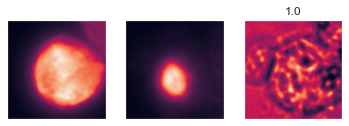

15590.240782920675
5767.058040093395
19527.426171304425


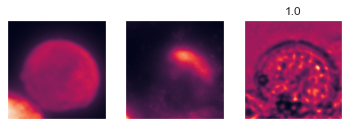

718.873535990715
3625.3493942022324
21066.097136855125


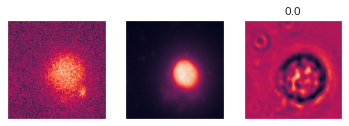

667.939443531687
2861.95188061198
20840.238269949616


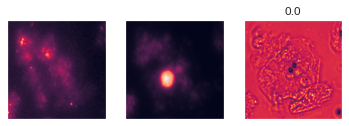

672.5233209133148
2872.5862860083585
21354.23055973649


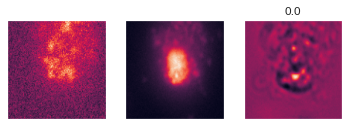

612.1489791870117
1800.9745903015137
21191.91529083252


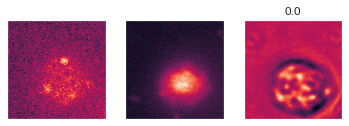

559.5214260865145
1566.3970835188873
21024.32433740396


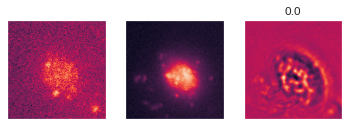

737.1533775334876
2046.4526927477477
21619.45399117531


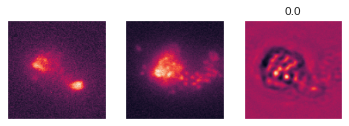

694.7633113265038
1906.294159591198
21498.35985291004


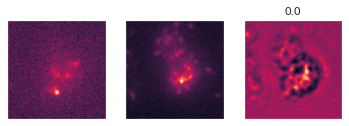

684.8742418954387
2410.7181937448086
21507.64546692212


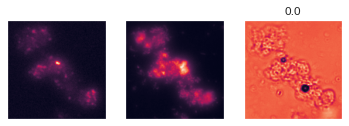

587.0543259876838
1508.0321598292317
20932.429498129288


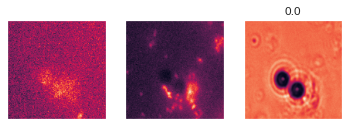

9863.365650405594
7183.355298207896
20014.520061519863


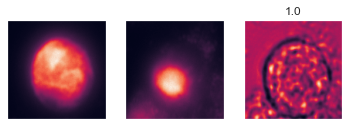

944.9116592252968
5615.63287800256
20065.035252156533


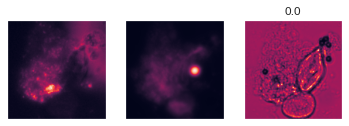

915.6332063279074
5330.468704082782
16877.41453098367


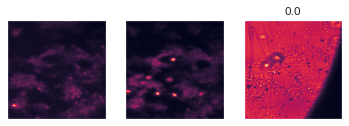

979.8980510121389
6495.620654078273
20331.40719621016


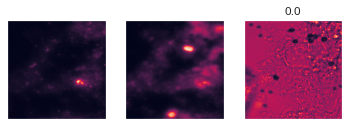

3736.679998550302
6959.059994662983
18688.52326192103


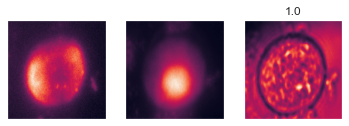

2379.447631212758
3570.362561865827
18360.792561185182


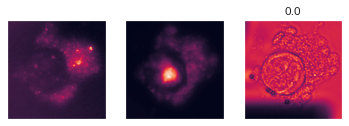

2372.160870669809
2210.0599079697495
11091.50373404009


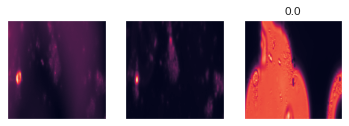

2102.384373720484
2583.728981187438
1361.377974055968


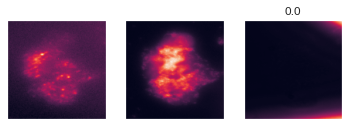

2443.2057049294726
2665.151108929126
10346.233347843447


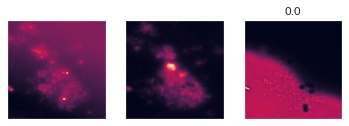

2197.9533482797497
2025.5792869178013
7571.006348008838


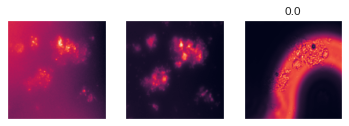

2096.0978478100824
2660.5324893162633
18851.204163330363


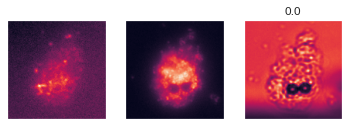

2079.174887351067
2572.714316604352
20783.19936401394


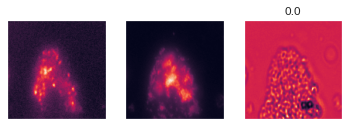

2209.65153637012
4415.425263413124
890.7738133882541


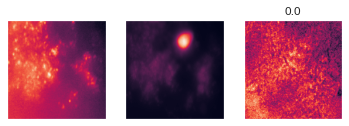

2098.272729419338
1832.676004477989
21169.859918517606


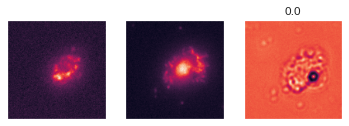

1987.945035484449
1605.307777752159
21159.473834611417


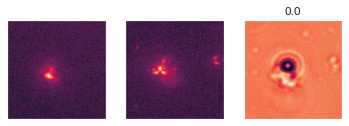

2046.1974873565937
1999.166991854548
16136.552000920798


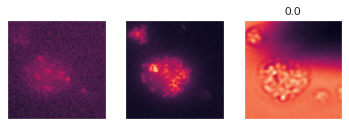

2837.2421359593463
2084.4883883877646
7637.034383313197


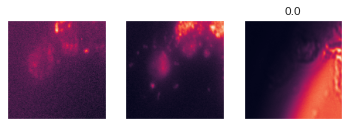

2916.554212122182
2042.3522454664146
1226.4899065071459


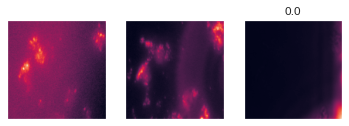

2100.3356259527245
1716.8858284161522
12256.09086551375


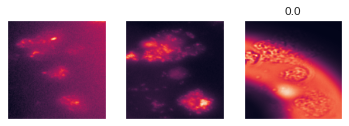

2130.357881769538
1728.8228080272675
21172.200509801507


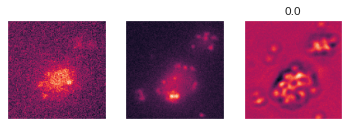

2259.3416276872504
1677.1229920983033
20628.50886255518


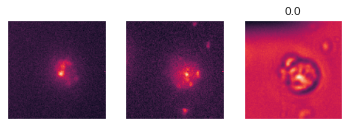

3376.7054825425153
2631.4445870667696
44455.62385468185


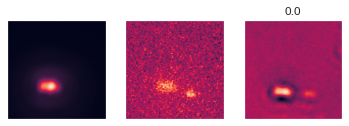

1144.9290237128735
2509.7801475524902
40066.2091704905


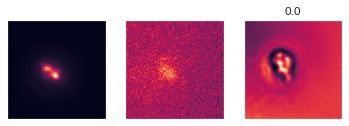

538.7025351524353
2724.2558578252792
45722.969445347786


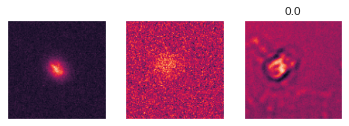

510.30312192440033
2710.8033670783043
43211.87795436382


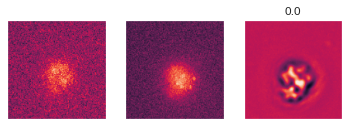

381.806419788295
1817.057158894805
42903.12929651633


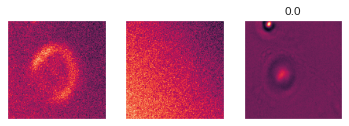

533.6415186822414
2930.735991537571
44058.613654345274


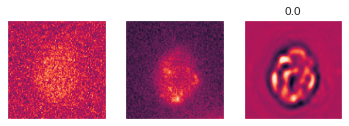

636.0683725476265
12561.757578462362
44082.08235527575


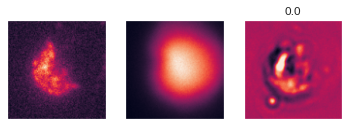

844.8309843065125
3584.9204119835945
41777.500169572486


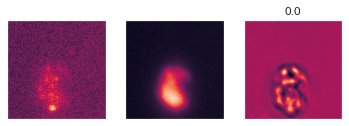

850.0511747325638
4983.186496150883
39585.80842569544


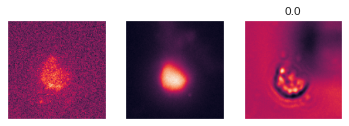

776.6661610515215
3041.040481659624
42245.1893962682


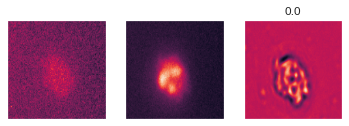

875.8500397503376
2966.440968424082
41361.63401547074


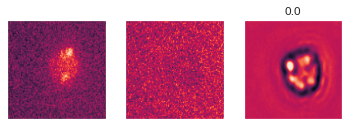

827.1974864006042
2933.5667033195496
41250.69919729233


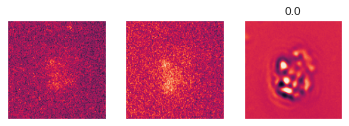

805.4818890094757
2712.1715729534626
41633.66051399708


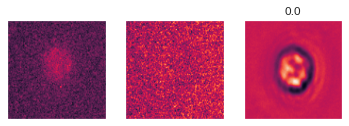

5167.692032217978
16897.22361159324
40703.23580014706


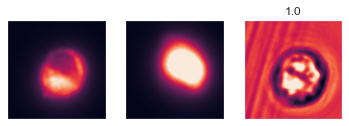

835.4621325433253
16425.153953641646
41647.71856404841


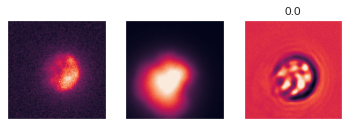

691.9527458548546
2717.630863070488
41491.67650914192


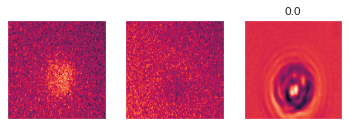

712.7551510334015
3060.1306593716145
41808.33816802502


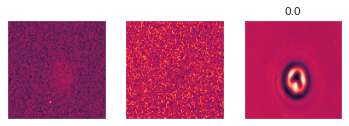

7422.543530352236
4523.250573992524
40523.5480808858


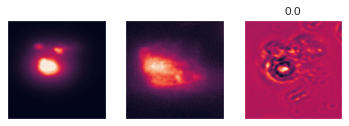

1034.1893119812007
3695.1388359069824
40652.9541053772


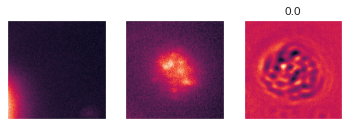

864.8642795427355
9325.926129650707
41678.297118126124


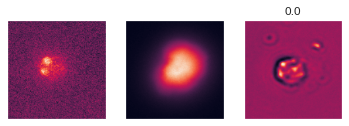

1493.2986666680627
4743.52665429956
39569.321068985155


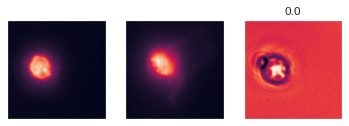

864.8707212805748
3477.943050324917
42035.738645255566


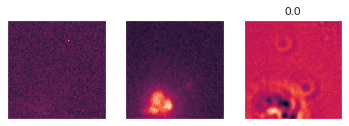

820.5205099943889
3325.2536755213077
40808.08462763569


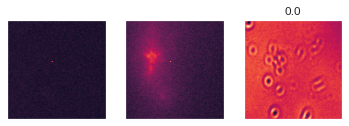

2004.0920314490786
4790.418309211729
40710.17051512003


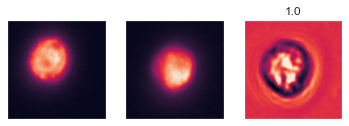

801.9782206267118
6238.261107757691
42241.78382983804


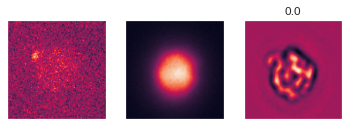

9403.588336467743
3058.6673769950867
42270.69122290611


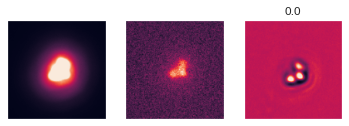

683.2115999013186
2300.1071877479553
39989.792710751295


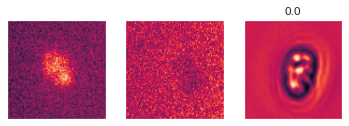

879.2842058539386
2904.9841603636687
41532.71009808782


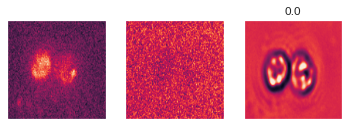

871.9114471971989
2930.87680670619
40199.779307216406


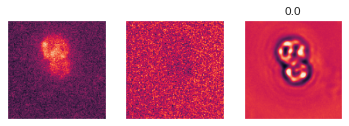

1269.854881286621
2810.728141784668
40985.728507995605


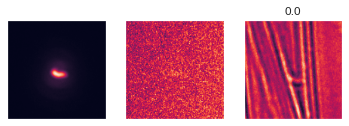

812.719085752964
6674.45195376873
41284.86257660389


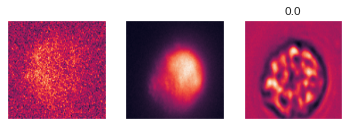

675.9665420651436
3124.6998963952065
40305.24657344818


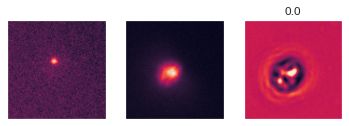

761.359463006258
3490.4459440410137
40790.251294732094


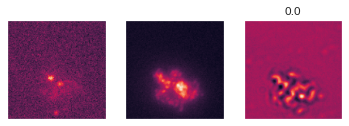

687.1284811496735
2593.2103757858276
40532.845202445984


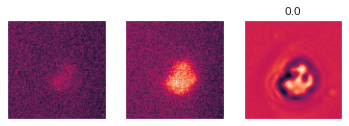

826.8615428209305
2916.1667879223824
39816.98076945543


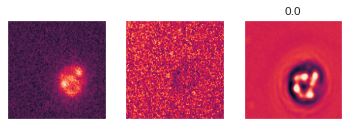

470.0839493274689
1745.4909979104996
39507.824771404266


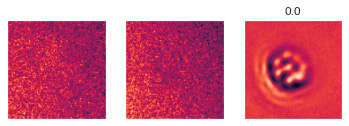

793.7091764724273
9353.304442024639
40763.52421548455


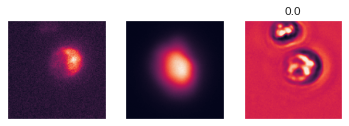

748.7841377556324
2443.3395842909813
40923.054932281375


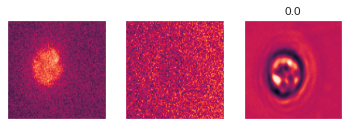

1626.6689594686031
2794.3241704702377
39062.2574570477


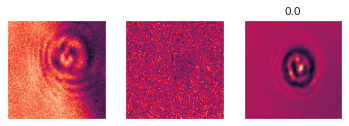

771.0215215269332
2757.7429501330253
39001.90402819954


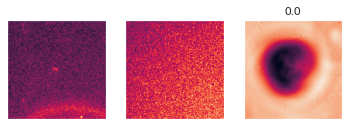

805.2954214811325
2875.411835551262
43002.1103938818


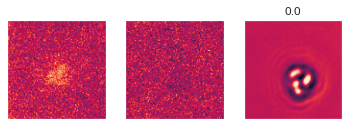

806.484849346682
2401.551072858175
41364.52024166954


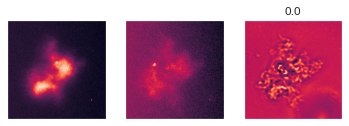

11696.795305049958
4597.848652618455
41198.78450661793


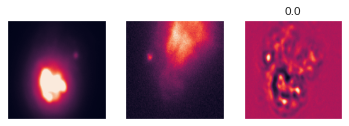

1896.8591567724945
4917.020876348019
39807.578090816736


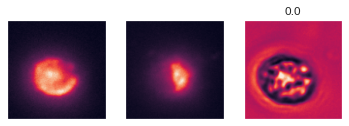

4236.320896056796
3002.8616026507325
41497.15575914443


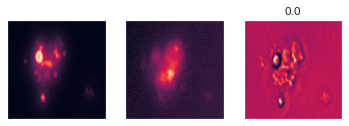

963.2030594622802
3433.7877612008606
41315.955588769815


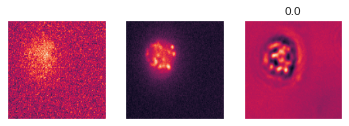

965.4015078135296
3318.0973203979866
40910.84416062938


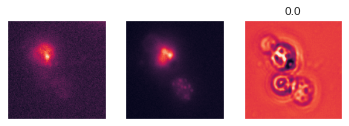

959.7651921510696
3583.7199996709824
41112.730194330215


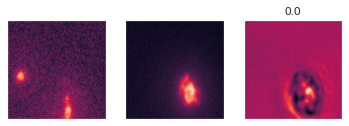

981.9828258156776
3311.3653678297997
41813.28053867817


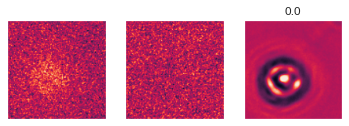

983.6288269758224
3143.9623769521713
41064.03029537201


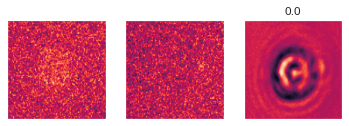

1004.3302442394693
5594.406062777532
41534.411170567364


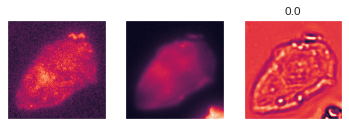

856.5123882293701
4420.840169668198
41126.905587911606


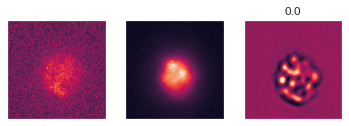

6258.42029964924
3717.6348851919174
41836.486102342606


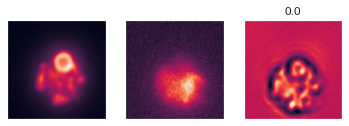

857.6511170864105
3254.462090730667
40919.37592983246


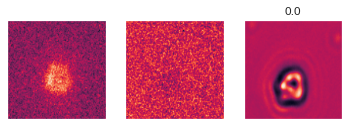

755.6452922821045
2886.7758708000183
40309.26038646698


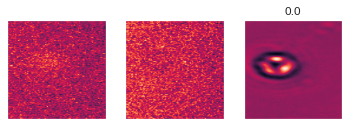

737.8014867603777
3071.449142307046
39445.915860101595


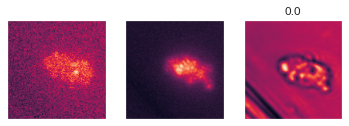

828.316452011466
3328.2001160383224
41092.40886846185


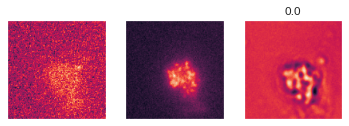

817.3049487237761
9872.995791814345
41198.56686163374


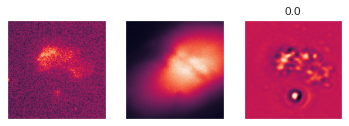

868.2718367576599
3585.735626220703
42626.1039891243


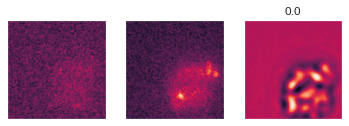

859.5763083696365
3450.6870979964733
41515.61504712701


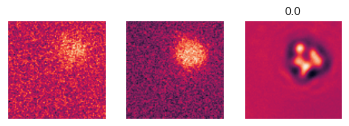

861.2251296043396
3540.63564991951
42634.862936258316


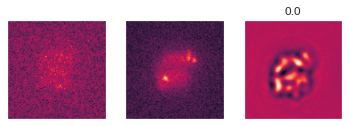

884.3447965979576
4216.495298862457
41653.48308146


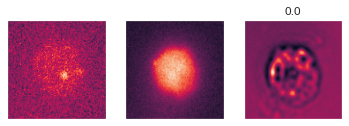

810.5000913805738
9936.669227781316
40968.37135604945


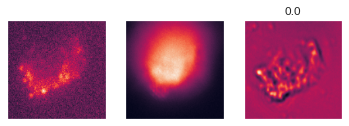

908.9244247408835
3736.83399118994
42858.981928601395


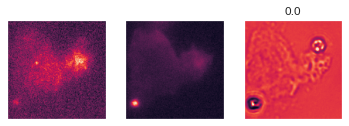

4979.665969848635
11132.643398284916
42600.25120162964


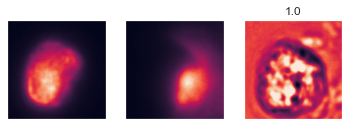

620.011074709194
7282.892887247905
44570.523961949424


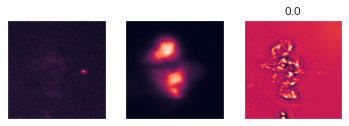

610.7423291598142
5761.264751550927
43455.43023702904


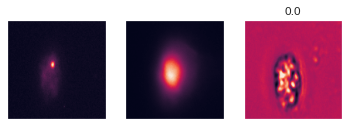

585.8946607772367
6570.952808835471
43123.88245537718


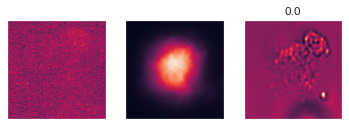

565.8581794527876
2906.384301974268
43239.24895660038


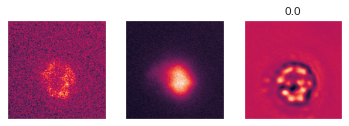

2622.806482145582
2378.9138180264263
43371.41838880473


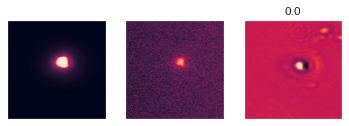

572.0255787376309
2529.578934669946
43438.703442568316


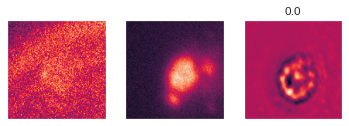

505.62267130932975
2224.841198983171
43193.25985476117


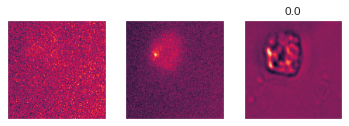

556.189461220466
3690.4344224463866
25638.792085695888


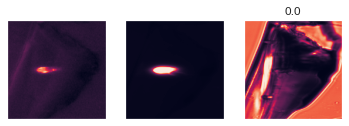

25561.47290638089
11459.411699026825
41769.40292328596


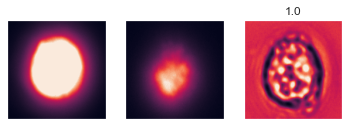

506.7958645816757
6605.986081564228
42833.350079546886


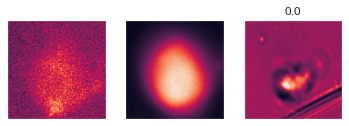

420.932999425577
5897.794080854318
43121.796916295425


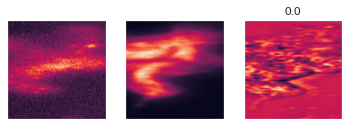

462.01155317283974
2460.339210082221
38337.97539971619


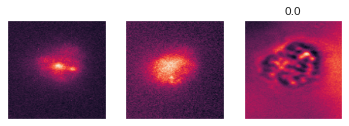

10005.067934513096
7108.878679648045
42368.172069728374


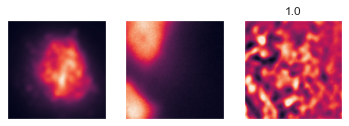

3086.507973313343
5439.174467027204
43162.43999630207


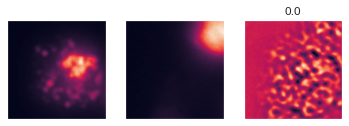

1057.0274506807332
12298.790295958523
40958.61459374429


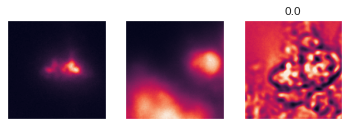

1144.6515428774107
8229.07896501185
41705.643453019555


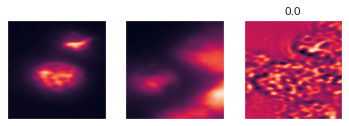

663.1815629042569
6231.335937040889
44927.647590879365


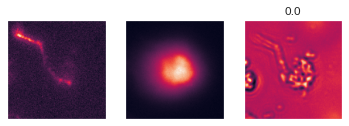

630.2015488502238
8909.890240219462
44101.122128425704


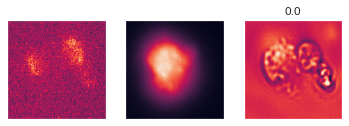

622.7772157931046
9538.760701948244
43272.551467061996


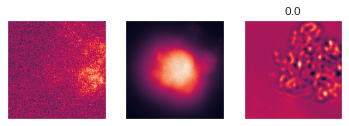

687.52809567962
7555.636543013746
43262.78984017262


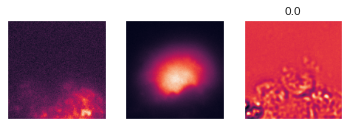

633.6098477830403
4524.461341719078
43581.932211185886


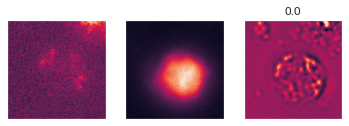

559.2750074653641
6342.854308939329
43139.967295711496


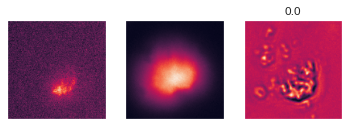

509.4308765549313
4081.0725502681044
43248.767721525444


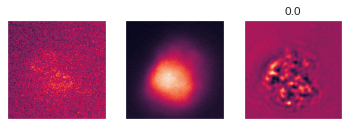

485.7662695050318
8346.188470482899
43205.682232201056


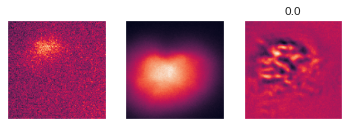

1347.1646936535858
10189.526286482811
43365.48003101349


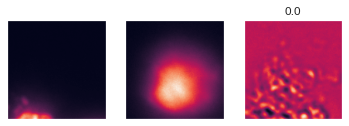

613.0021249194692
8459.387469529414
43579.44386998525


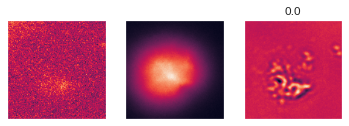

618.6053057163954
3729.806266173721
43689.71791793406


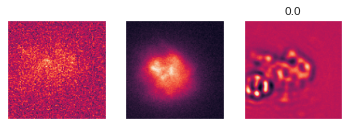

597.313747786921
9104.81174963856
43199.75793199221


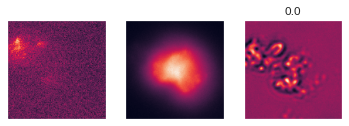

23775.052085876465
14222.86371243
43835.689868927


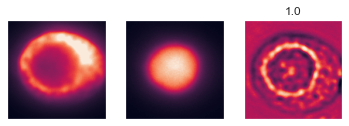

11369.850529819721
19959.890216439948
43329.411305338144


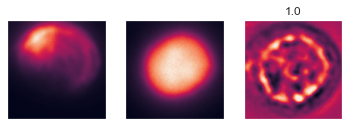

622.858092085537
5607.233615866239
42742.44424164391


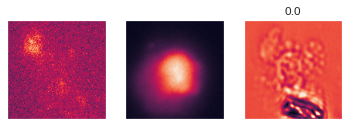

659.3292391598225
5780.195807486771
43572.004819244146


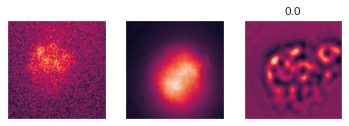

368.7304351967791
4612.744594754428
43417.78539908669


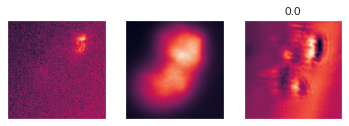

392.0878096980061
5044.602210176432
45146.83517075627


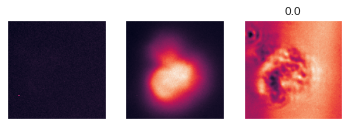

446.1033492254451
5459.645743039052
44163.48610917412


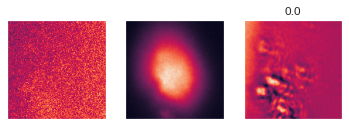

458.3826636573216
5485.482688554508
44107.616057115796


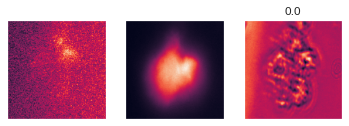

542.6680806321315
10260.483312597786
43095.615466659816


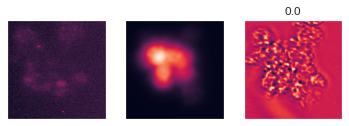

437.6712667529798
5618.254003046573
44641.92031556559


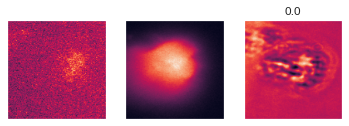

536.0267241058606
2973.508798807409
43100.91656982733


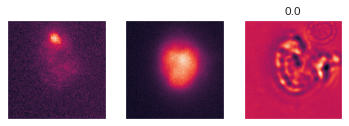

618.3694419819071
7596.230766309478
39067.95368412432


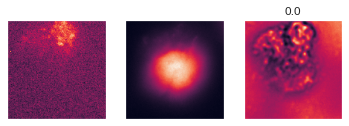

619.2394834291613
7433.951947360917
46461.610569237455


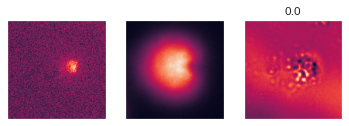

643.3529640635593
7367.960597413279
46069.65295535973


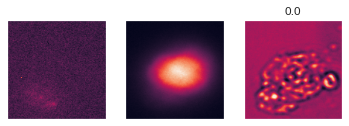

626.9026370602973
9857.059584182609
43339.5553259535


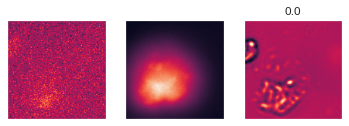

637.008911776895
6508.5965342801255
43422.13621036719


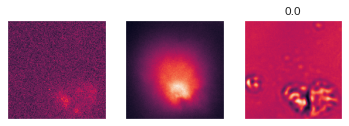

629.006255305206
7720.112530681223
42746.046709535745


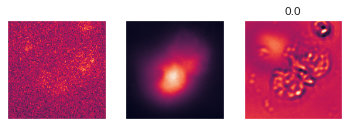

583.1495536528473
9443.487675426182
43774.90625047621


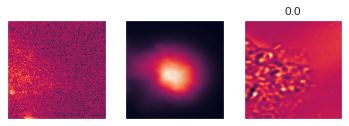

366.85588329774896
6385.207592345579
42542.051276451166


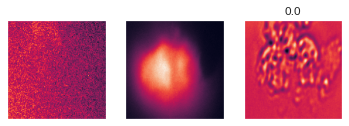

549.5670914764148
10044.205723002147
42419.95591257737


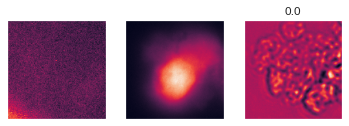

448.010507045047
4395.995984579236
43298.509489729666


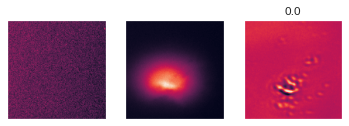

567.0613668236347
10706.204208841453
43289.15028038922


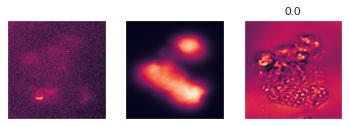

633.8759930040696
7161.659003129908
43402.793238947386


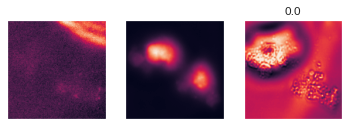

621.4215162447531
8499.224213554022
43290.024115766326


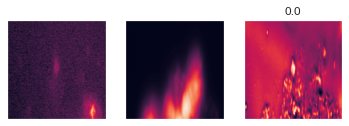

522.1661854951052
3803.8068843917476
44048.41065473112


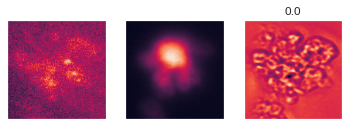

429.8521681637309
4333.055954504542
44322.617198732216


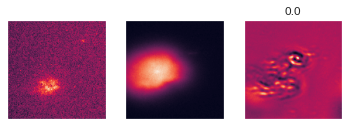

469.7393873333914
2470.5220507383146
43451.35206955662


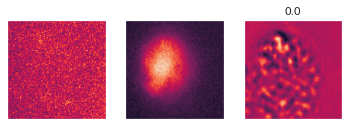

675.729219655633
2988.4737471088674
43831.375887041395


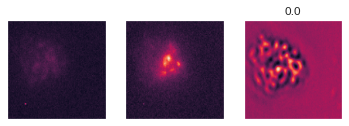

657.0276833432994
3530.0140050092905
41798.16265182312


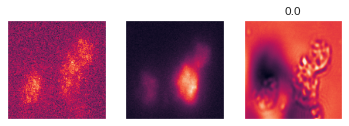

16126.877730790693
10388.52002125102
23898.567119397652


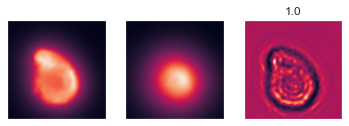

6629.020167042434
9232.033405401311
22291.73394625241


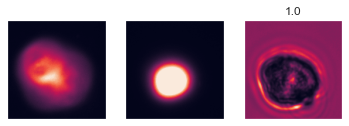

1195.1101282243376
896.7651353931997
23848.07871339794


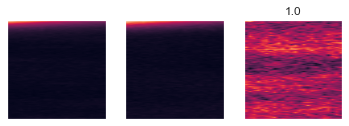

29635.98948624733
16914.566123217362
22446.0423438102


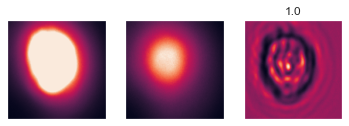

2144.9482907474217
645.7537136193301
23774.6776502629


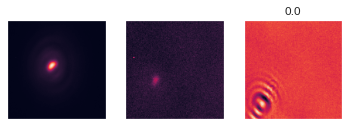

11606.707472313177
6080.796171556306
23778.48928086441


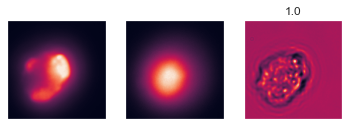

16621.181600334836
6753.100457578112
22793.928418883173


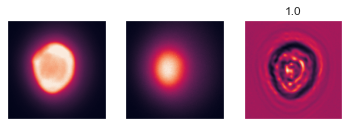

7071.2115948962055
14465.765406261662
23167.551478131165


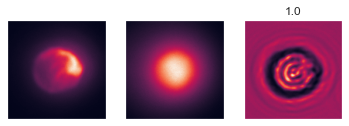

11546.794998581414
17925.465241780043
23609.898508892074


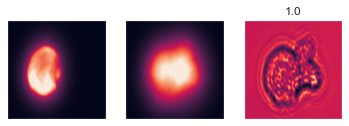

25324.636115264962
15126.67269359187
23280.07295399714


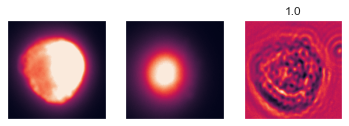

20195.160629686412
9545.642012522805
22661.12338221941


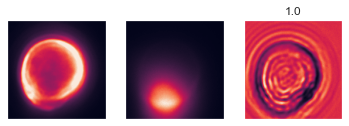

17222.411506848828
10972.236614928614
20936.594258038982


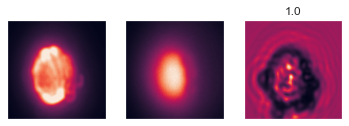

34084.094715084015
22909.61195566925
22596.072063873962


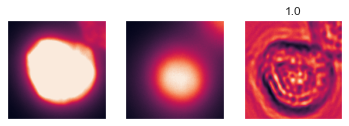

25558.690998823102
16361.20423611857
22830.652636358907


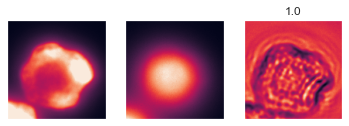

7907.00465345406
906.6025595663136
25718.40961813732


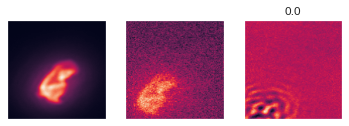

1119.2656692173828
3520.335536177805
22791.75533444476


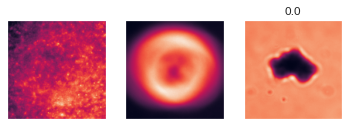

1033.5339276800603
814.6673365836706
25720.88039851207


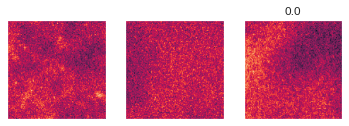

1022.0413882732391
775.2224683761597
25147.54075717926


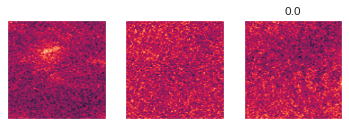

808.4887771606445
932.8267669677734
24004.401077270508


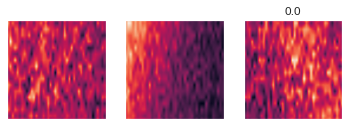

1142.342752514748
8893.269336430862
23523.469854273277


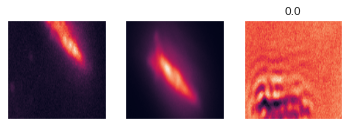

21741.424126171354
9634.023478464835
24594.117932108507


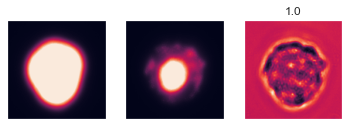

1215.0844479203224
813.3699210882187
25145.250354349613


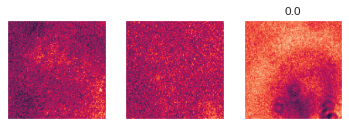

1286.7005033940077
793.9005282223225
24982.523428604007


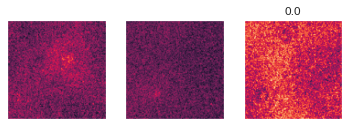

1210.9532651901245
755.8515567779541
24663.148882865906


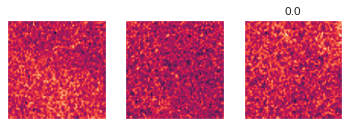

1195.280390739441
766.3000199794769
24778.133255958557


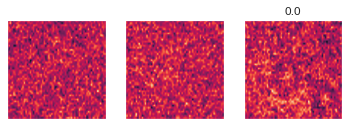

1257.9231204986572
823.4521434307098
24517.72132062912


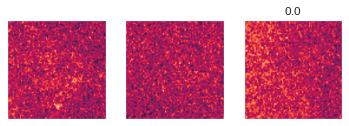

1116.1006743609905
801.9693573415279
24706.510258853436


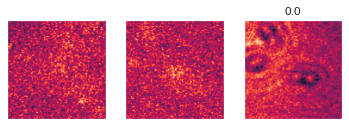

1182.8812564015388
1021.0516200065612
24464.103728830814


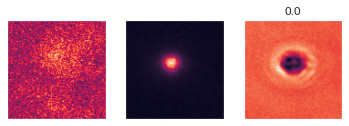

13045.912616867134
12304.955371956352
23720.177592292406


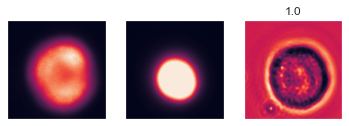

22901.75459309425
15369.591003834394
21721.01029758101


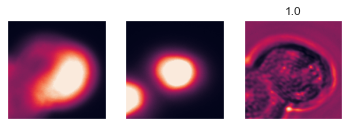

19352.48216074502
15927.8240609768
21673.188905964947


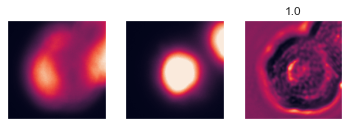

1275.4954576333305
972.3893830930625
25657.305121429665


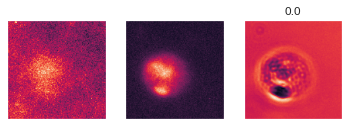

1281.5334579348773
847.4093836844219
25464.576899856198


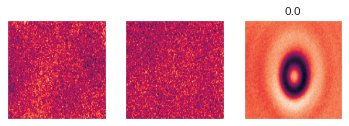

29641.078478634365
12753.970030248169
32700.28384757042


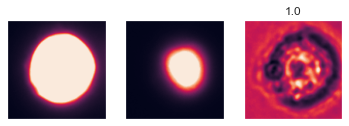

35466.82472363114
12462.736246153712
31958.561591640115


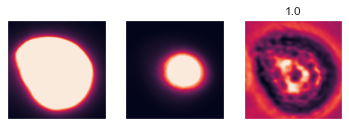

29391.474936406845
8035.374467380072
35646.84937849187


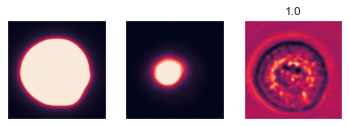

28709.19573616981
2560.143657028675
34992.97308164835


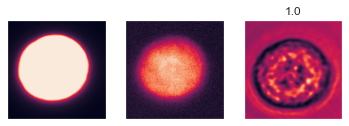

10138.979238510135
2753.0039246082306
36385.708886384964


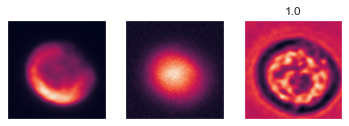

5055.175770401955
2030.6753931343555
40071.3202714026


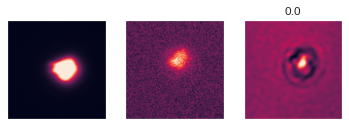

3682.365491151809
1978.0322205424309
38878.90201586485


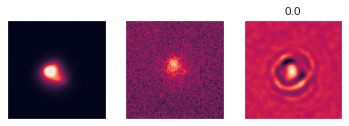

4279.0465536137235
2024.7371978767123
38593.005157469335


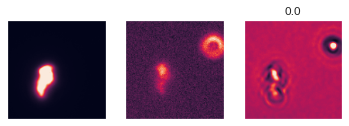

5202.530652761542
2086.692575381133
35032.436884965195


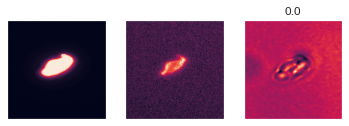

6389.943169405896
1524.9027292716978
34299.84949515999


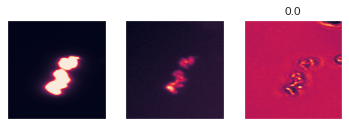

7814.0812965178375
1224.7109002710529
28744.192404127283


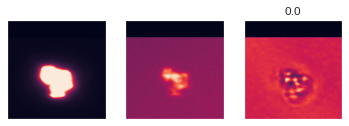

776.724155032628
2649.3419950525367
31529.64117784841


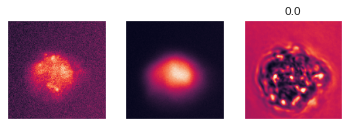

970.8249858490178
2059.424720203371
35667.16717428163


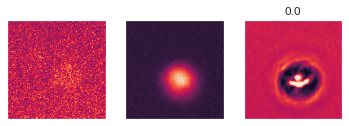

975.5790151121246
2019.2835913514198
35490.463037674795


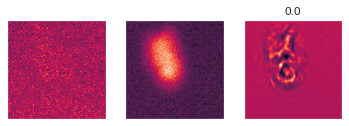

917.603819714185
2421.9853406254583
34950.83147382839


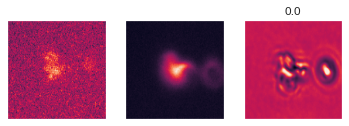

986.4961952865104
2232.503535330296
36920.588640138405


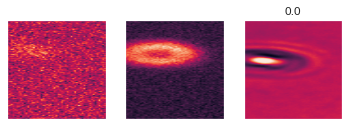

954.9832298457623
2090.7361430227757
34929.00237503648


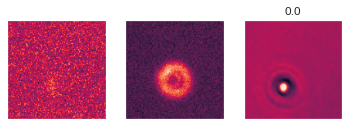

1134.096438407898
2216.941864967346
34162.131549835205


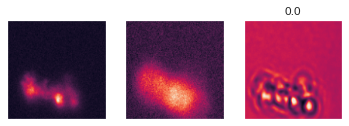

940.8511588573456
2096.821857511997
33680.02309679985


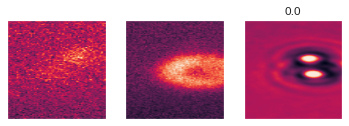

902.5643193994621
1940.1308885209528
35183.84515703368


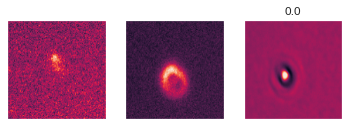

933.8021602630615
2055.7903270721436
35209.219650268555


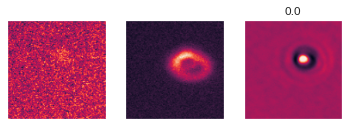

1212.5849173069
2090.526054382324
35943.979085445404


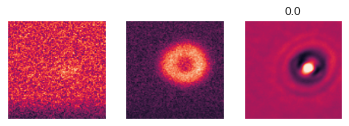

1177.8211844861507
2142.301044613123
36565.499362796545


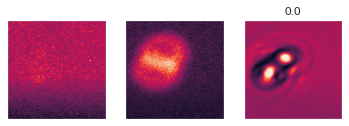

878.5304321050644
2895.1936559081073
33131.36120390892


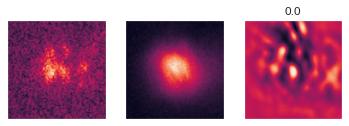

1138.391634941101
2113.0720295906067
35484.150357723236


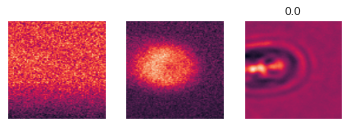

1224.8470746725798
2176.8153536468744
31831.01028548181


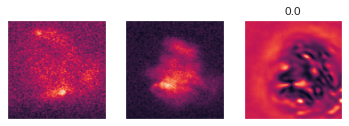

1240.6120972931385
2312.2545582205057
35989.80533443391


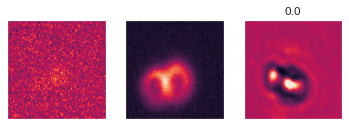

1237.7620871067047
2102.9634371995926
37618.71971619129


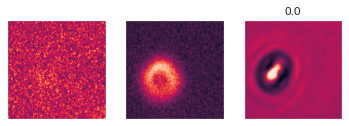

1256.302534520626
2272.449610441923
36051.996308252215


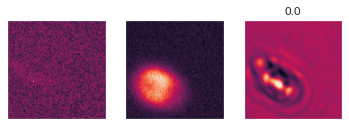

1250.1859888136387
2218.1024184823036
36404.819648876786


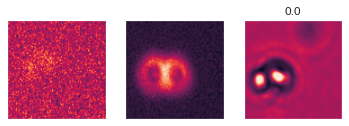

1194.698173880577
2111.199948787689
35623.62624895573


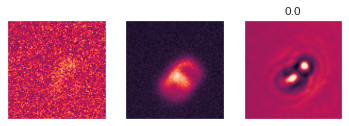

882.7632598671867
1705.6029405106751
35164.62897527637


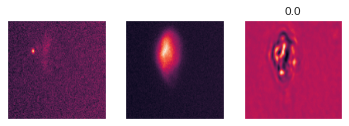

1536.4868983383058
2648.4147722488774
33979.09344862778


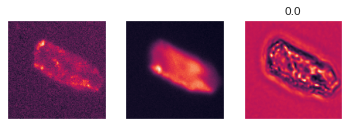

1519.969094215266
2518.9333265824807
34116.44449117898


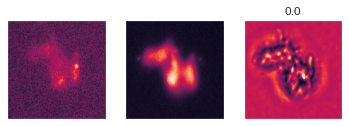

1357.714662826527
2099.155332465678
34885.14632627619


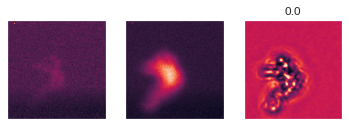

1406.2669110298204
2280.631764292718
35537.77492946385


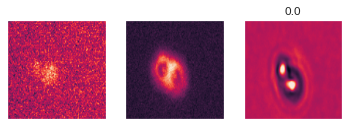

1347.7603318691254
2122.27527654171
34096.20896947384


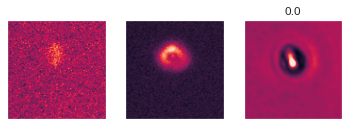

2132.210503544653
1849.6084757624535
7358.57689217006


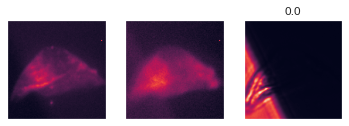

1439.5322593152523
2276.620740443468
35338.90833745897


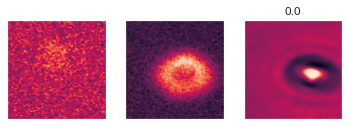

1373.497462272644
2111.366461277008
36035.725944042206


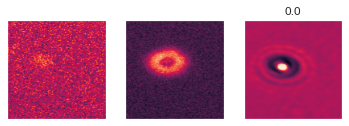

1430.6188006401062
2088.4705052375793
36468.205340862274


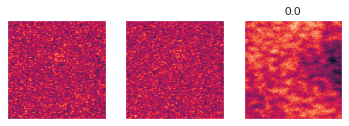

1426.6281808018684
2081.568880677223
36613.86965838075


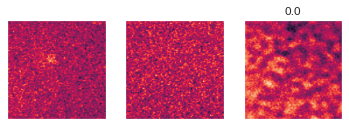

1226.5390930175781
1953.1359100341797
34790.359954833984


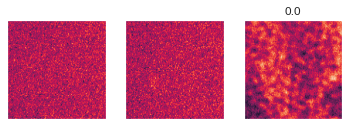

1268.377385288477
1936.7006568312645
34452.64456033707


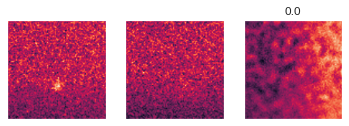

1168.5063210725784
1798.002540588379
34469.001038104296


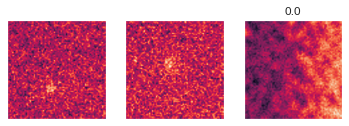

722.3304069838384
607.742443860164
1358.905070409673


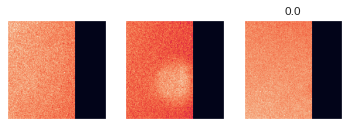

1289.6861260086298
1877.8130804151297
35317.45415018499


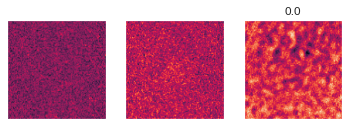

1223.896410882473
1744.992813050747
35386.444729447365


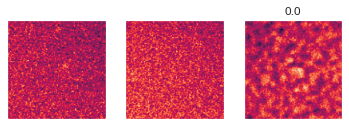

1234.5828730668195
1722.2325702411852
35830.513496245614


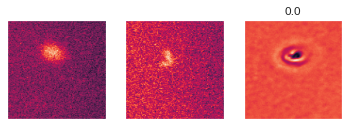

800.6421045443346
1199.9874361012926
36030.4866977746


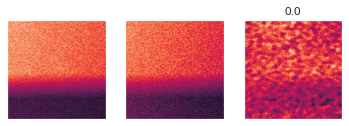

1040.3566427230835
1721.1209725141525
34808.91499662399


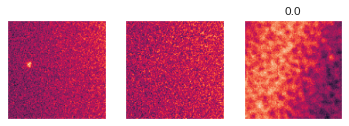

900.2148804664612
1547.8402707576752
35037.18227505684


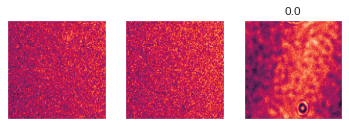

678.4304268956184
1507.7740474045277
35312.43637603521


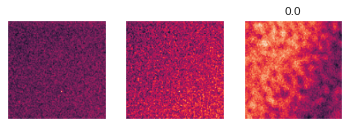

818.7299730479717
1786.7558742165565
35321.738619983196


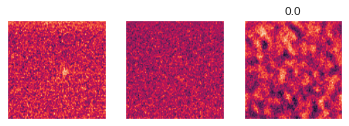

832.059939622879
1838.9562695026398
35532.888628959656


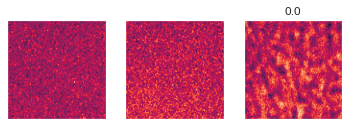

864.5810234099627
1947.0478676259518
35627.26494446397


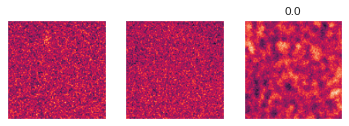

860.5365089774132
1886.5900700092316
34949.024968236685


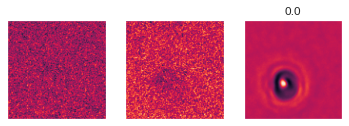

924.2679746598005
1849.1992730647326
33250.21460406482


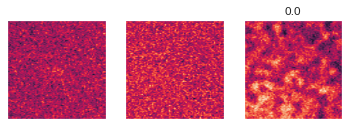

903.1084325760603
1910.685125052929
38153.524178013206


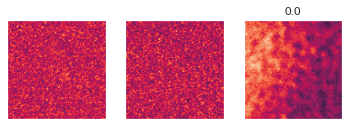

901.1132915616035
1916.8486819565296
39059.0128249228


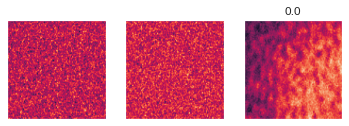

1049.9837120175362
1792.291553556919
34252.06016856432


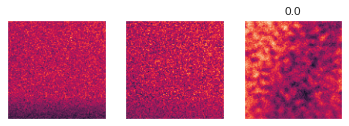

993.8453548748048
1860.6147483077916
35581.16309028473


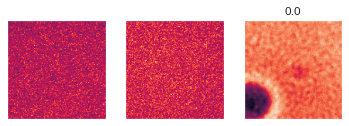

1109.869813233614
2036.3933323323727
35755.37246096134


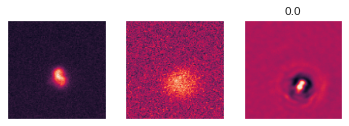

1045.7351064682007
2018.136041045189
35304.38124501705


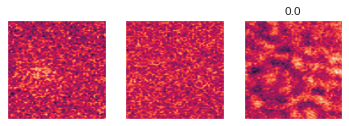

1085.937541693449
2022.6146340072155
35834.654456973076


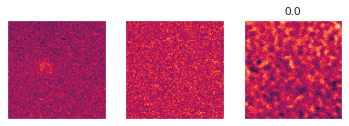

1103.0517745018005
2022.2654476165771
35727.72825717926


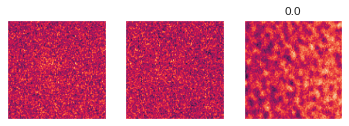

1126.6819694638257
2012.0004636645322
35798.76954728365


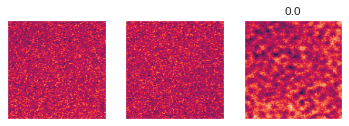

1041.06516289711
1856.9601655006409
36322.436114788055


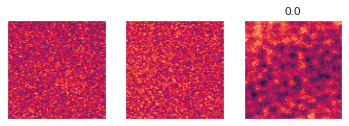

1052.6648317277431
2010.668591439724
35674.984291791916


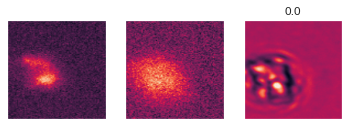

966.4292826652527
1936.486205816269
35733.86835718155


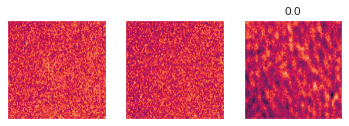

769.4455736279488
1569.0818954855204
33272.45301306248


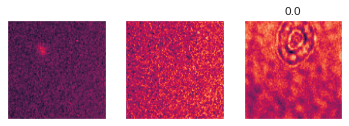

716.5652108192444
1492.9477288722992
35444.85091203451


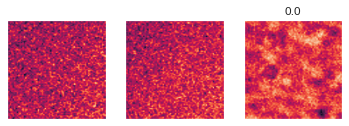

770.8083192408085
1588.4860282540321
35288.6171335578


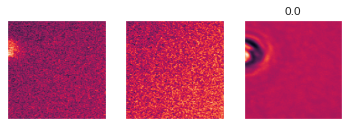

850.8705679029226
1760.81380815804
34632.24959516525


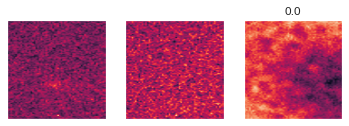

882.9238805174828
1817.2733508944511
35298.17509585619


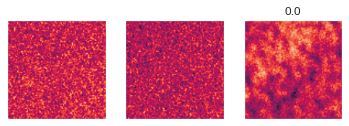

976.3350271582603
1759.0380254983902
34567.807822823524


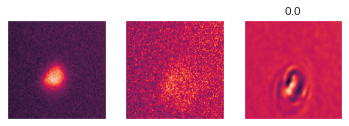

1059.0653356015682
1824.1964428126812
35006.138548731804


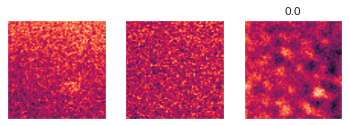

1100.183358952403
1898.1022626906633
35116.29748560488


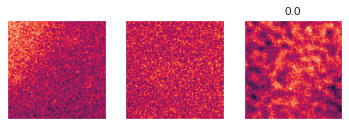

1057.510748386383
1969.0763119757175
35216.79978373647


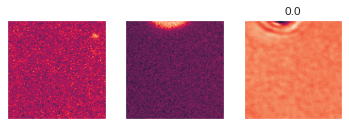

1192.2728491775943
1815.7688601442378
34599.52632936592


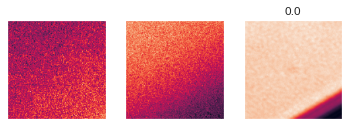

1253.24998831749
1620.313302010298
24664.45257204771


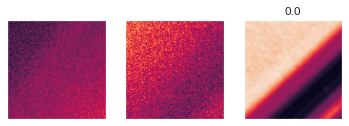

1050.3706144094467
1919.483535706997
35115.85196109116


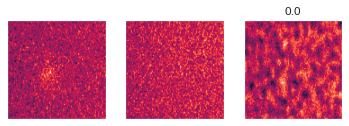

1055.559909582138
1884.4457870721817
35037.212759017944


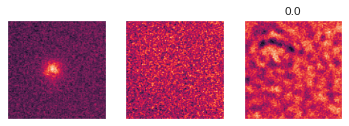

1102.4389395713806
1993.059004932642
35037.982878148556


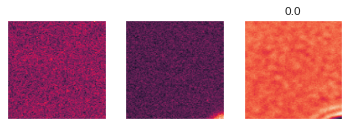

1118.998971670866
2005.8267152905464
35675.70560699701


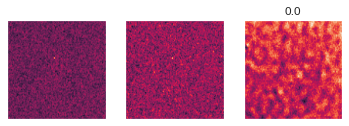

938.8819307088933
2055.869244158272
35356.80300337082


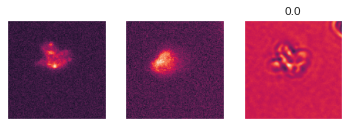

942.6192916929724
1967.8100987374783
38929.75742536783


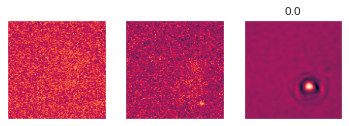

939.7252172231674
1710.2809186577797
36858.157952070236


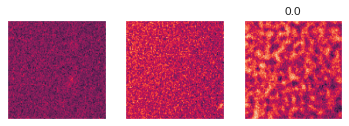

878.1963011041463
1584.568172269347
36242.56597510836


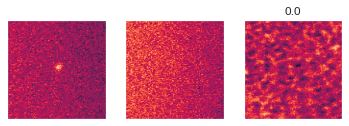

871.8990557193756
1506.6621527671814
36197.131047964096


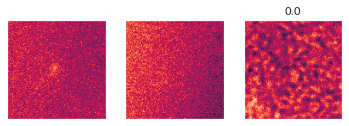

947.4922404289246
1835.8161463737488
37030.33337175846


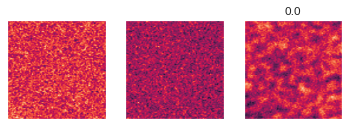

948.6224862337112
1828.9164347052574
37073.20139181614


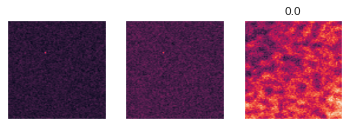

5228.145879805088
3318.6971204280853
35743.7967838645


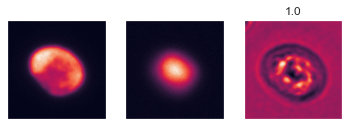

23077.02344560623
11323.509807229042
33404.55364409089


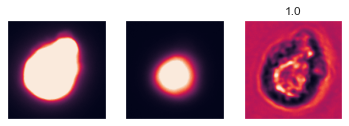

5205.535667145687
5476.76419994402
33392.39798623622


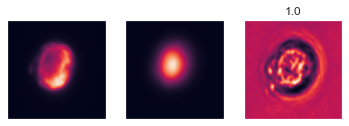

19622.045641244888
8640.498735272919
34687.00250430897


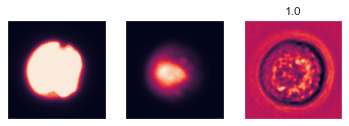

953.8884278646494
2096.2712519732445
36839.81100173158


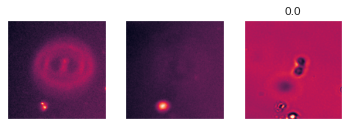

1266.8137992818142
2139.8113807606896
36112.57918799523


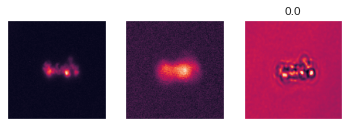

654.1931824470307
1795.947239214015
34918.92985033576


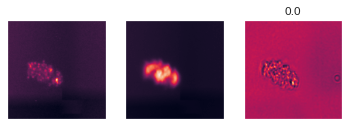

971.997828798583
2658.8680086004656
34174.55715399921


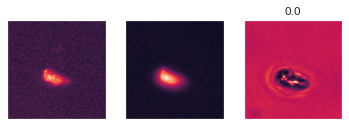

595.6001317613443
1511.9654781314332
35124.30080012197


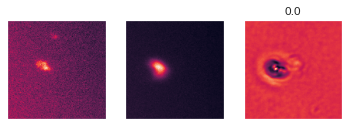

959.6640840953726
2332.1106531402957
36981.21279726675


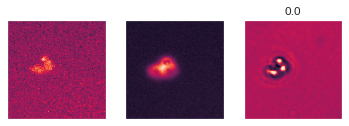

3471.698071002961
2413.158139705658
35106.100704193115


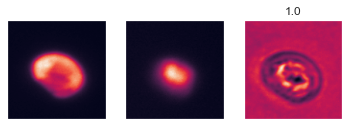

12475.919817328433
9521.69128930569
35359.42681646347


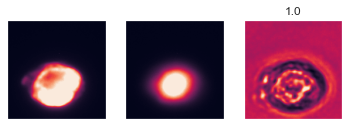

20378.14185108773
7812.428207989411
36445.69996330894


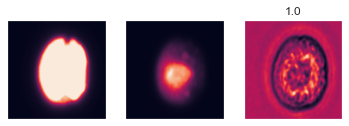

22471.546700941435
7800.989663241111
34317.91226299349


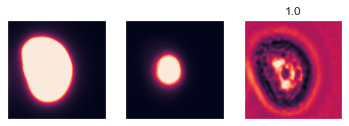

13228.699661952309
6174.091790237651
35908.30947354412


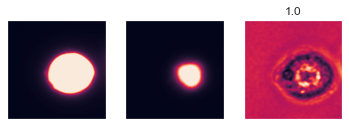

26208.453935911322
4491.97930222389
34676.70992471014


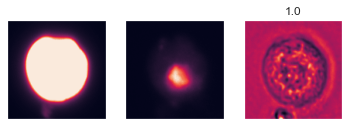

22072.666052269095
7673.477625378536
33098.522847386776


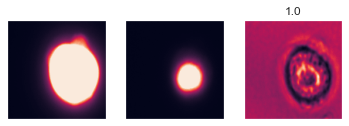

1089.7387380157697
2180.194718023502
35995.01383030077


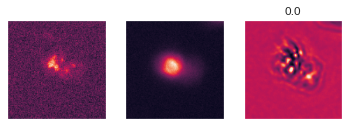

1798.6028423504235
2077.664949734883
36182.47743010869


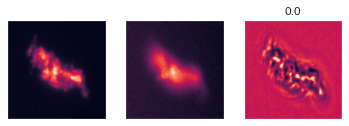

658.125309235948
2719.781467757634
35525.35188823714


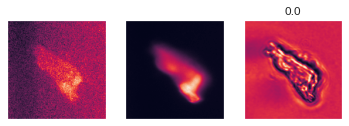

952.5897054076195
2589.8003412485123
35844.69674772024


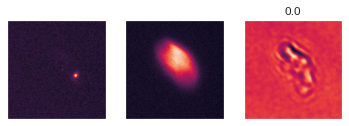

2943.3454787598193
2024.700480685338
36141.375424406


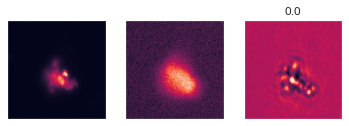

18099.245736990644
2354.3141515684583
34597.569036497545


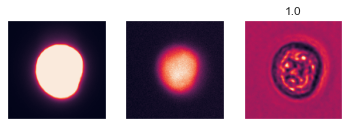

17163.65648471984
6601.628841250333
34277.0863095321


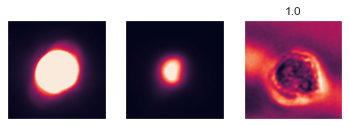

542.7952548945286
1551.3261210359128
35727.79810788867


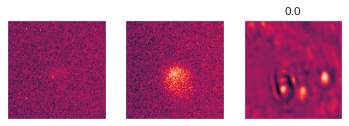

371.74931117061175
1357.5766033753425
1753.344830028113


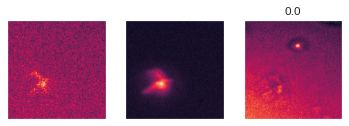

12592.221598535769
3263.224268525838
35329.25609403849


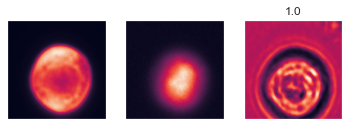

16461.92821778356
1776.6358877420423
35908.455512061715


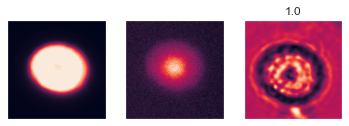

11566.698292493815
3149.311167955397
34231.59760260582


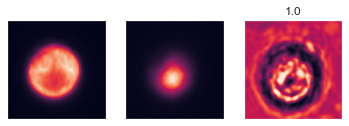

8912.735890073951
2766.108600118788
35404.76104969334


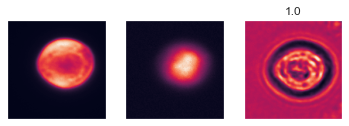

558.345371754817
2123.501825085359
36669.1189294707


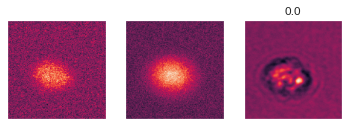

533.6822431385517
2626.80471393466
34026.195142537355


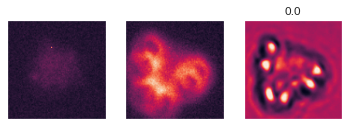

673.7147084474564
3890.0799873322226
34244.38894636929


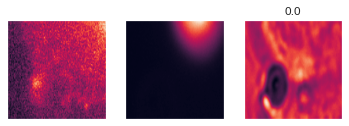

27947.49252484854
2447.6162548895154
35371.33787565952


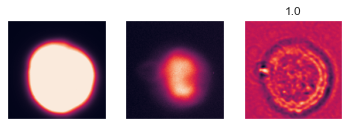

17089.994222570873
4014.9932258640943
36107.12464499181


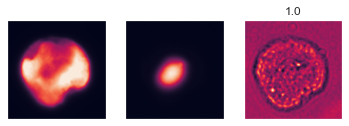

575.585507273674
29576.4473541975
38332.466738820076


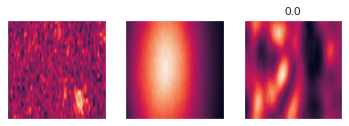

546.7598702696985
1790.1033511097687
32102.546822731252


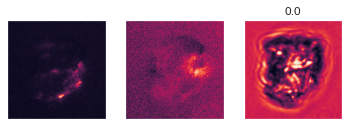

420.1271581420149
1913.8703628105654
35383.724688042494


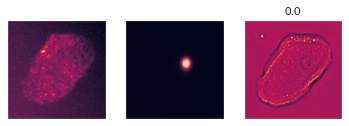

584.5636686243417
3142.6807704469566
35277.099873992105


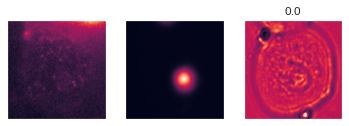

22537.81238410223
4913.913477375119
35412.86149717864


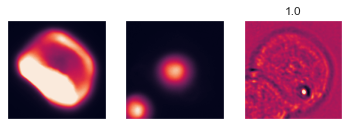

12908.115144666646
5863.629469677139
35402.8853008826


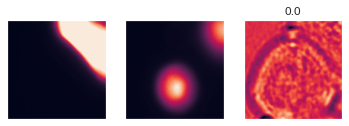

In [29]:
for i in range(x_train_net.shape[0]):
    f, ax = plt.subplots(1,3)
    for j in range(3):
        ax[j].imshow(x_train_net[i,...,j])
        print(np.mean(x_train_net[i,...,j]))
        ax[j].set_xticks([])
        ax[j].set_yticks([])
    plt.title(y_train_net[i])
    plt.show()

In [18]:
df_net = pd.DataFrame()

df_net['size'] = [np.sqrt(d[2].shape[0] * d[2].shape[1]) for d in gr1] + [np.sqrt(d[2].shape[0] * d[2].shape[1]) for d in gr2]
# print(np.mean(df['size']))
# df['488 Intensity'] = [np.mean(img) for img in x+]
df_net['647 Intensity'] = [np.mean(img) for img in x_train1[..., 0]] + [np.mean(img) for img in x_train2[..., 0]]
df_net['DAPI Intensity'] = [np.mean(img) for img in x_train1[..., 1]] + [np.mean(img) for img in x_train2[..., 1]]
df_net['BF Intensity'] = [np.mean(img) for img in x_train1[..., 2]] + [np.mean(img) for img in x_train2[..., 2]]
# df_net = normalize(df_net)
df_net['type'] = [d[0] for d in gr1] + [d[0] for d in gr2]
df_net['sample'] = [d[-1] for d in gr1] + [d[-1] for d in gr2]
# df['stain'] = ['fetal_647_maternal_555'] * 459

pos = df_net[df_net['type']=='Positive']
neg = df_net[df_net['type']=='Negative']

df_net

,size,647 Intensity,DAPI Intensity,BF Intensity,type,sample
0,145.492268,22096.841084,8709.620912,19393.746833,Positive,57-w4-2
1,171.988372,15590.240783,5767.058040,19527.426171,Positive,57-w4-2
2,142.912561,718.873536,3625.349394,21066.097137,Negative,57-w4-2
3,505.331574,667.939444,2861.951881,20840.238270,Negative,57-w4-2
4,145.677727,672.523321,2872.586286,21354.230560,Negative,57-w4-2
...,...,...,...,...,...,...
315,222.090072,546.759870,1790.103351,32102.546823,Negative,69-w7
316,434.161260,420.127158,1913.870363,35383.724688,Negative,69-w7
317,284.871901,584.563669,3142.680770,35277.099874,Negative,69-w7
318,274.463112,22537.812384,4913.913477,35412.861497,Positive,69-w7


<AxesSubplot:xlabel='size', ylabel='Density'>

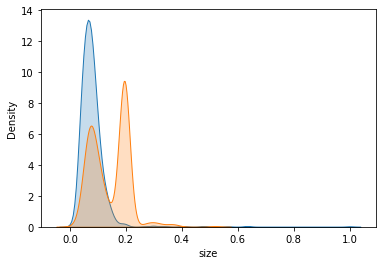

In [15]:
pos_old = df_old[df_old['type']=='Positive']['size']
neg_old = df_old[df_old['type']=='Negative']['size']
sns.kdeplot(pos_old, fill=True)
sns.kdeplot(neg_old, fill=True)

<AxesSubplot:xlabel='size', ylabel='Density'>

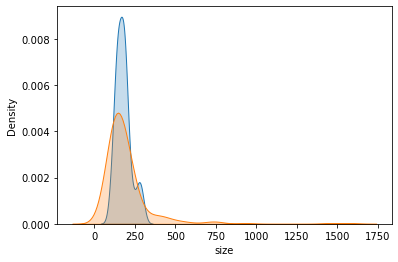

In [16]:
pos_new = df_net[df_net['type']=='Positive']['size']
neg_new = df_net[df_net['type']=='Negative']['size']
sns.kdeplot(pos_new, fill=True)
sns.kdeplot(neg_new, fill=True)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
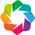

:AdjointLayout
   :Overlay
      .Points.I  :Points   [647 Intensity,DAPI Intensity]   (size,BF Intensity,type,sample)
      .Points.II :Points   [647 Intensity,DAPI Intensity]   (size,BF Intensity,type,sample)
   :Histogram   [DAPI Intensity]   (DAPI Intensity_count)
   :Histogram   [647 Intensity]   (647 Intensity_count)

In [40]:
hv.extension('bokeh')
p = df_net[df_net['type']=='Positive']
n = df_net[df_net['type']=='Negative']
points1 = hv.Points(p, kdims=['647 Intensity', 'DAPI Intensity'])
points2 = hv.Points(n, kdims=['647 Intensity', 'DAPI Intensity'])

xhist, yhist = histogram(points1, dimension='DAPI Intensity') * histogram(points2, dimension='647 Intensity')

(points1*points2) << xhist.opts() << yhist

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
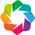

:Overlay
   .Points.Fetal_555_fetal_647          :Points   [size,DAPI Intensity]   (BF Intensity,555 Intensity,647 Intensity,type,sample,stain)
   .Points.Fetal_555_maternal_647_cvs   :Points   [size,DAPI Intensity]   (BF Intensity,555 Intensity,647 Intensity,type,sample,stain)
   .Points.Fetal_555_maternal_647       :Points   [size,DAPI Intensity]   (BF Intensity,555 Intensity,647 Intensity,type,sample,stain)
   .Points.Fetal_647_maternal_555       :Points   [size,DAPI Intensity]   (BF Intensity,555 Intensity,647 Intensity,type,sample,stain)
   .Points.Fetal_555_fetal_647_n        :Points   [size,DAPI Intensity]   (BF Intensity,555 Intensity,647 Intensity,type,sample,stain)
   .Points.Fetal_555_maternal_647_cvs_n :Points   [size,DAPI Intensity]   (BF Intensity,555 Intensity,647 Intensity,type,sample,stain)
   .Points.Fetal_555_maternal_647_n     :Points   [size,DAPI Intensity]   (BF Intensity,555 Intensity,647 Intensity,type,sample,stain)
   .Points.Fetal_647_maternal_555_n     :Points   [size,DAPI Intensity]   (BF Intensity,555 Intensity,647 Intensity,type,sample,stain)

In [39]:
%%opts Histogram (alpha=0.3)
%%output size=200

hv.extension('bokeh')
pos = []
neg = []
for s in df_old['stain'].unique():
    # separate by stain
    sub = df_old[df_old['stain'] == s]    
    # separate by pos/neg
    p = sub[sub['type']=='Positive']
    pos.append(hv.Points(p, kdims=['size', 'DAPI Intensity'], label=s))
    n = sub[sub['type']=='Negative']
    neg.append(hv.Points(n, kdims=['size', 'DAPI Intensity'], label=s+'_n'))
    
# neg[0].opts(size=5)
composition = (pos[0].opts(marker='+', size=5)
               * pos[1].opts(marker='+', size=5)
               * pos[2].opts(marker='+', size=5)
               * pos[3].opts(marker='+', size=5)
               * neg[0].opts(size=5)
               * neg[1].opts(size=5)
               * neg[2].opts(size=5)
               * neg[3].opts(size=5))
composition.opts(opts.Histogram(alpha=0.3, height=600, width=600))

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
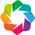

:AdjointLayout
   :Points   [size,647 Intensity]   (DAPI Intensity,BF Intensity,type,sample)
   :Histogram   [size]   (size_count)
   :Histogram   [DAPI Intensity]   (DAPI Intensity_count)

In [44]:
import numpy as np
import holoviews as hv
from holoviews.operation import histogram
hv.extension('bokeh')






p_points = hv.Points(pos)
n_points = hv.Points(neg)
# xhist, yhist = (histogram(pos))*histogram(neg)
p_points.hist(dimension=['DAPI Intensity', 'size'], )
# n_points.hist(dimension=['DAPI Intensity', 'size'])

In [13]:
# %%opts Histogram (alpha=0.3)
from holoviews import opts
points1 = hv.Points(pos, kdims=['size', 'DAPI Intensity'])
points2 = hv.Points(neg, kdims=['size', 'DAPI Intensity'])
xhist, yhist = (histogram(points1, dimension=dim) * 
               histogram(points2, dimension=dim)
               for dim in ['size', 'DAPI Intensity'])
# points1*points2
# points2
composition = points1.opts(color='green', marker='+', size=5) * points2.opts(color='r', marker='+', size=5) << yhist.opts(width=125) << xhist.opts(height=125)
# (points1* points2) << yhist.opts(width=125) << xhist.opts(height=125)
composition.opts(opts.Histogram(alpha=0.3))


NameError: name 'histogram' is not defined

In [92]:
points

:Points   [size,488 Intensity]   (647 Intensity,DAPI Intensity,BF Intensity,type,sample,stain)

C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\distributions.py:1678: UserWarning: `shade_lowest` is now deprecated in favor of `thresh`. Setting `thresh=0.4`, but please update your code.
  warnings.warn(msg, UserWarning)


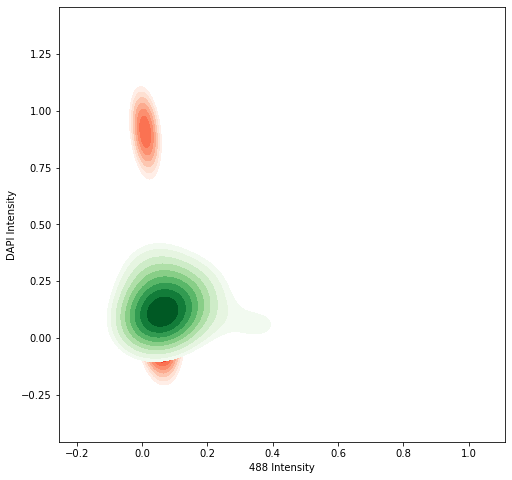

In [6]:
f, ax = plt.subplots(figsize=(8, 8))
# ax.set_aspect("equal")
df_p = df[df['type'] == 'Positive']
df_n = df[df['type'] == 'Negative']
ax = sns.kdeplot(df_n['488 Intensity'], df_n['DAPI Intensity'],
                 cmap="Reds", thresh=.4, shade=True)
ax = sns.kdeplot(df_p['488 Intensity'], df_p['DAPI Intensity'],
                 cmap="Greens", shade=True, thresh=.4, shade_lowest=False)

C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\distributions.py:1678: UserWarning: `shade_lowest` is now deprecated in favor of `thresh`. Setting `thresh=0.2`, but please update your code.
  warnings.warn(msg, UserWarning)


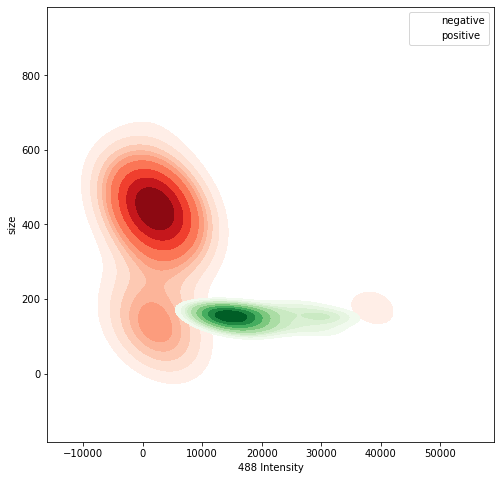

In [31]:
f, ax = plt.subplots(figsize=(8, 8))
# ax.set_aspect("equal")
df_p = df[df['type'] == 'Positive']
df_n = df[df['type'] == 'Negative']
ax = sns.kdeplot(df_n['488 Intensity'], df_n['size'],
                 cmap="Reds", thresh=.2, shade=True)
ax = sns.kdeplot(df_p['488 Intensity'], df_p['size'],
                 cmap="Greens", shade=True, thresh=.2, shade_lowest=False)


<AxesSubplot:xlabel='size', ylabel='DAPI Intensity'>

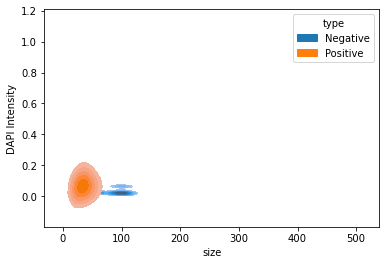

In [163]:
sns.kdeplot(data=df_old, x='size', y='DAPI Intensity', hue='type', color=['red', 'green'], fill=True, thresh=.2)

C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, 'DAPI')

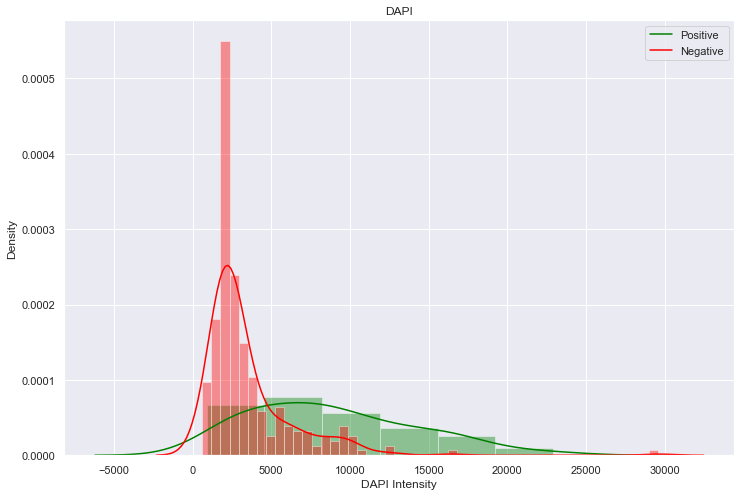

In [22]:
sns.set()
f, ax = plt.subplots(figsize=(12, 8))
ax = sns.distplot(pos['DAPI Intensity'], color='green')
ax = sns.distplot(neg['DAPI Intensity'], color='red')
ax.legend(['Positive', 'Negative'])
ax.set_title('DAPI')

C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, 'Size')

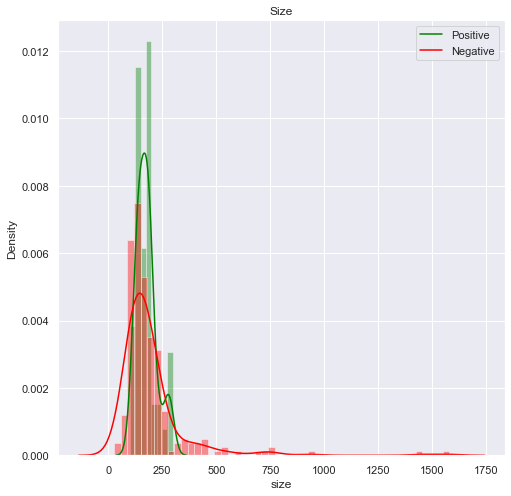

In [24]:
f, ax = plt.subplots(figsize=(8, 8))
ax = sns.distplot(pos['size'], color='green')
ax = sns.distplot(neg['size'], color='red')
ax.legend(['Positive', 'Negative'])
ax.set_title('Size')

C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, '647 Intensity')

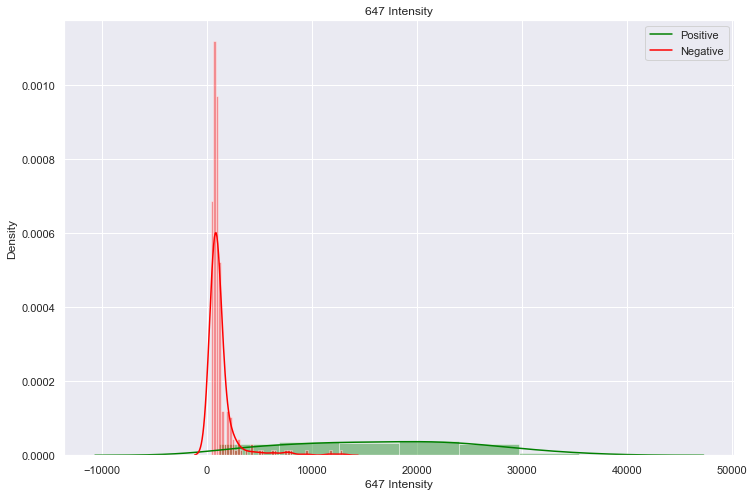

In [25]:
f, ax = plt.subplots(figsize=(12, 8))

ax = sns.distplot(pos['647 Intensity'], color='green')
ax = sns.distplot(neg['647 Intensity'], color='red')
ax.legend(['Positive', 'Negative'])
ax.set_title('647 Intensity')

C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, 'BF Intensity')

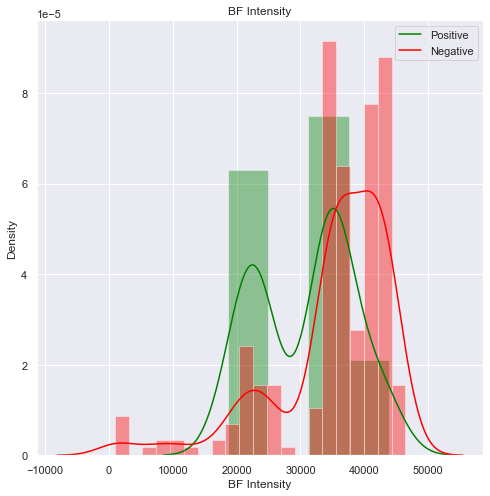

In [26]:
f, ax = plt.subplots(figsize=(8, 8))

ax = sns.distplot(pos['BF Intensity'], color='green')
ax = sns.distplot(neg['BF Intensity'], color='red')
ax.legend(['Positive', 'Negative'])
ax.set_title('BF Intensity')

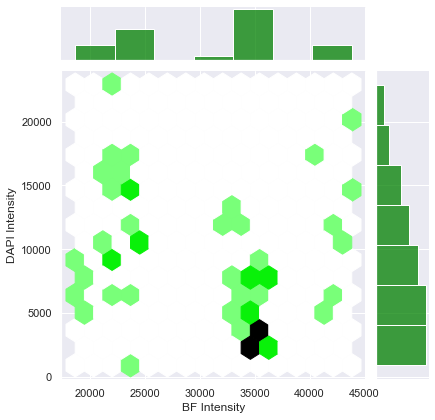

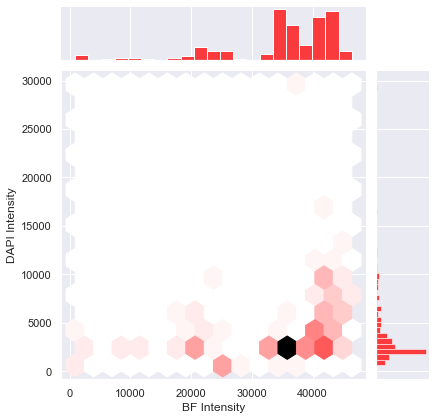

In [27]:
joint_kws=dict(gridsize=15)
sns.jointplot(x=pos['BF Intensity'], y=pos['DAPI Intensity'], kind='hex', bins=50, joint_kws=joint_kws, color='green')
sns.jointplot(x=neg['BF Intensity'], y=neg['DAPI Intensity'], kind='hex', bins=50, joint_kws=joint_kws, color='red')

C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\distributions.py:1649: FutureWarning: The `vertical` parameter is deprecated and will be removed in a future version. Assign the data to the `y` variable instead.
  warnings.warn(msg, FutureWarning)
C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\distributions.py:1649: FutureWarning: The `vertical` parameter is deprecated and will be removed in a future version. Assign the data to the `y` variable instead.
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.01, 'Meta Data Distribution')

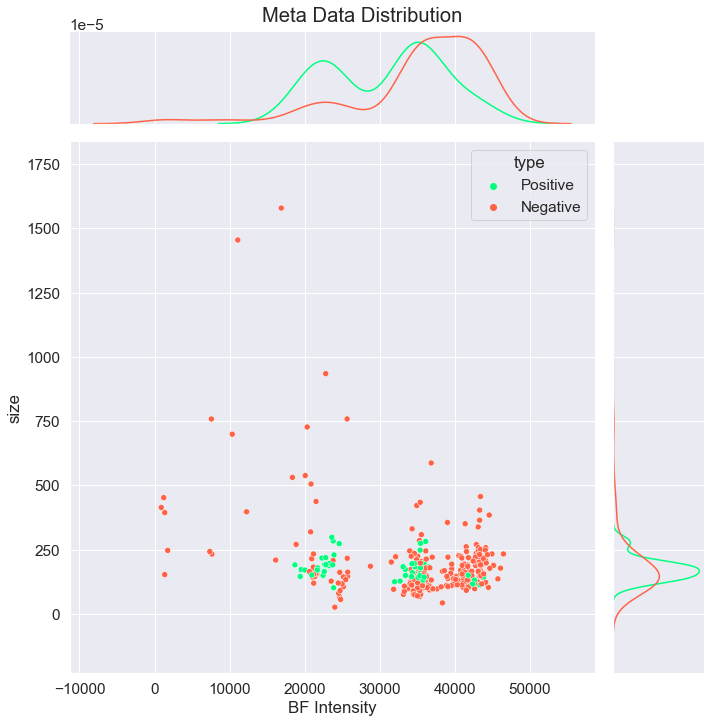

In [35]:
sns.set(font_scale=1.4)

p = df_net[df_net['type']=='Positive']
n = df_net[df_net['type']=='Negative']
df_net

grid = sns.JointGrid(x='BF Intensity', y='size', height=10, data=df_net)
g = grid.plot_joint(sns.scatterplot, hue='type', data=df_net, palette =['springgreen', 'tomato'])

sns.kdeplot(p['BF Intensity'], ax=g.ax_marg_x, color='springgreen')
sns.kdeplot(p['size'], ax=g.ax_marg_y, vertical=True, color='springgreen')

sns.kdeplot(n['BF Intensity'], ax=g.ax_marg_x, color='tomato')
sns.kdeplot(n['size'], ax=g.ax_marg_y, vertical=True, color='tomato')

plt.suptitle('Meta Data Distribution', y=1.01)

C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\distributions.py:1649: FutureWarning: The `vertical` parameter is deprecated and will be removed in a future version. Assign the data to the `y` variable instead.
  warnings.warn(msg, FutureWarning)
C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\distributions.py:1649: FutureWarning: The `vertical` parameter is deprecated and will be removed in a future version. Assign the data to the `y` variable instead.
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.01, 'Meta Data Distribution')

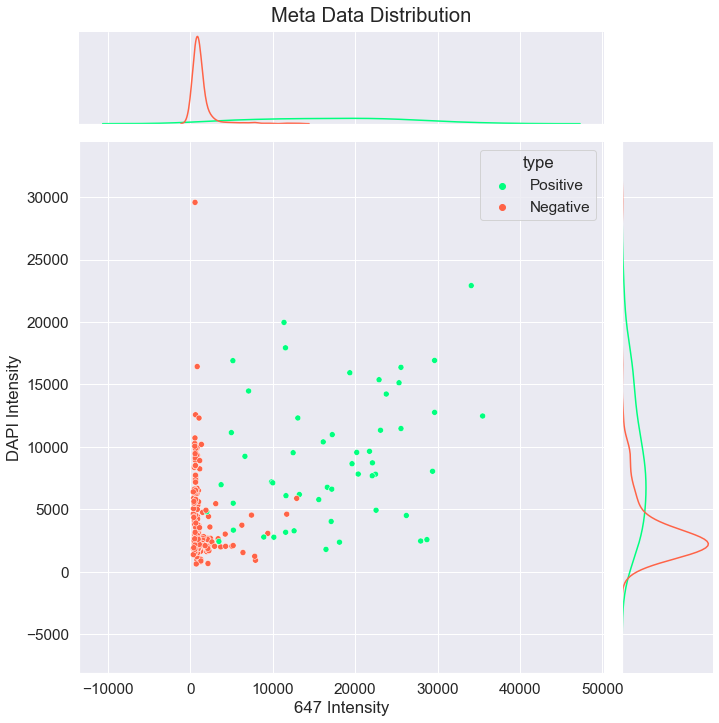

In [37]:
sns.set(font_scale=1.4)

p = df_net[df_net['type']=='Positive']
n = df_net[df_net['type']=='Negative']
df_net

grid = sns.JointGrid(x='647 Intensity', y='DAPI Intensity', height=10, data=df_net)
g = grid.plot_joint(sns.scatterplot, hue='type', data=df_net, palette =['springgreen', 'tomato'])

sns.kdeplot(p['647 Intensity'], ax=g.ax_marg_x, color='springgreen')
sns.kdeplot(p['DAPI Intensity'], ax=g.ax_marg_y, vertical=True, color='springgreen')

sns.kdeplot(n['647 Intensity'], ax=g.ax_marg_x, color='tomato')
sns.kdeplot(n['DAPI Intensity'], ax=g.ax_marg_y, vertical=True, color='tomato')

plt.suptitle('Meta Data Distribution', y=1.01)

C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, '647 (ck7) Intensity (w/o Sample 78)')

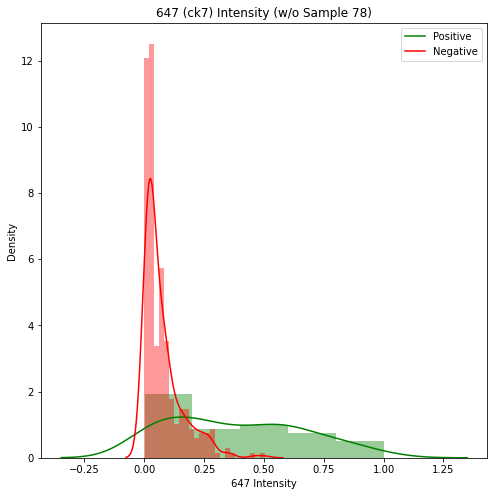

In [10]:
f, ax = plt.subplots(figsize=(8, 8))
df_f = df[df['Sample']!='78']
df_p = df_f[df_f['type'] == 'Positive']
df_n = df_f[df_f['type'] == 'Negative']
ax = sns.distplot(df_p['647 Intensity'], color='green')
ax = sns.distplot(df_n['647 Intensity'], color='red')
ax.legend(['Positive', 'Negative'])
ax.set_title('647 (ck7) Intensity (w/o Sample 78)')

C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, '488 (cd45/vim) Intensity (w/o Sample 78)')

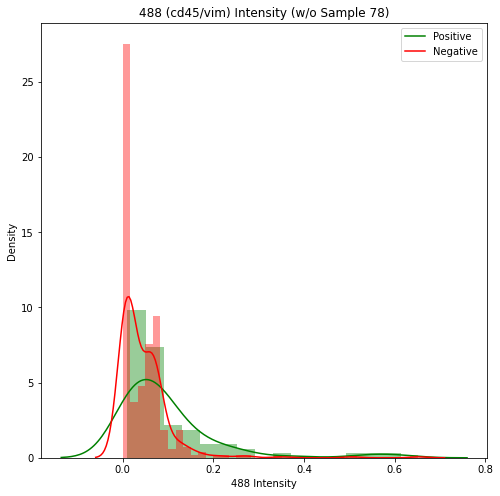

In [11]:
f, ax = plt.subplots(figsize=(8, 8))
df_f = df[df['Sample']!='78']
df_f = df_f[df_f['Sample']!='w2']
df_p = df_f[df_f['type'] == 'Positive']
df_n = df_f[df_f['type'] == 'Negative']
ax = sns.distplot(df_p['488 Intensity'], color='green')
ax = sns.distplot(df_n['488 Intensity'], color='red')
ax.legend(['Positive', 'Negative'])
ax.set_title('488 (cd45/vim) Intensity (w/o Sample 78)')

C:\Users\Harrison\Anaconda3\envs\lcl_mk2_annotation\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\Harrison\Anaconda3\envs\lcl_mk2_annotation\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, 'Sample 78 - 647 (cgb) Intensity')

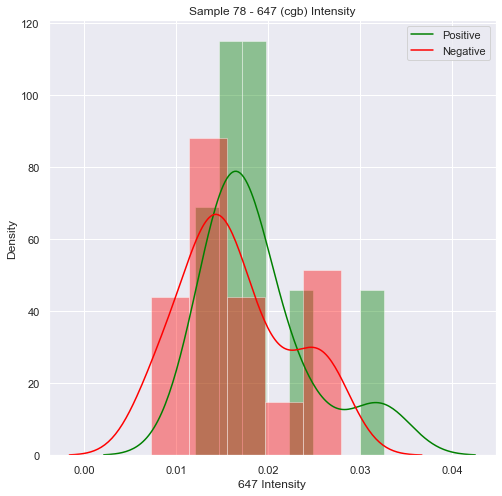

In [75]:
f, ax = plt.subplots(figsize=(8, 8))
df_f = df[df['Sample']=='78']
df_p = df_f[df_f['type'] == 'Positive']
df_n = df_f[df_f['type'] == 'Negative']
ax = sns.distplot(df_p['647 Intensity'], color='green')
ax = sns.distplot(df_n['647 Intensity'], color='red')
ax.legend(['Positive', 'Negative'])
ax.set_title('Sample 78 - 647 (cgb) Intensity')

C:\Users\Harrison\Anaconda3\envs\lcl_mk2_annotation\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\Harrison\Anaconda3\envs\lcl_mk2_annotation\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, 'Sample 78 - 488 (ck7) Intensity')

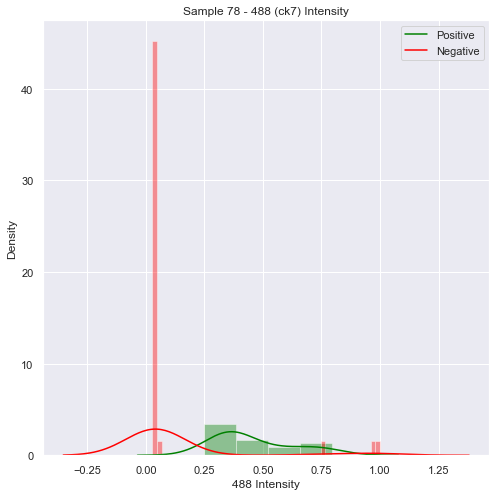

In [76]:
f, ax = plt.subplots(figsize=(8, 8))
df_f = df[df['Sample']=='78']
df_p = df_f[df_f['type'] == 'Positive']
df_n = df_f[df_f['type'] == 'Negative']
ax = sns.distplot(df_p['488 Intensity'], color='green')
ax = sns.distplot(df_n['488 Intensity'], color='red')
ax.legend(['Positive', 'Negative'])
ax.set_title('Sample 78 - 488 (ck7) Intensity')

C:\Users\Harrison\Anaconda3\envs\lcl_mk2_annotation\lib\site-packages\seaborn\distributions.py:1184: UserWarning: No contour levels were found within the data range.
  **contour_kws,
C:\Users\Harrison\Anaconda3\envs\lcl_mk2_annotation\lib\site-packages\seaborn\distributions.py:1184: UserWarning: No contour levels were found within the data range.
  **contour_kws,
C:\Users\Harrison\Anaconda3\envs\lcl_mk2_annotation\lib\site-packages\seaborn\distributions.py:1184: UserWarning: No contour levels were found within the data range.
  **contour_kws,
C:\Users\Harrison\Anaconda3\envs\lcl_mk2_annotation\lib\site-packages\seaborn\distributions.py:1184: UserWarning: No contour levels were found within the data range.
  **contour_kws,


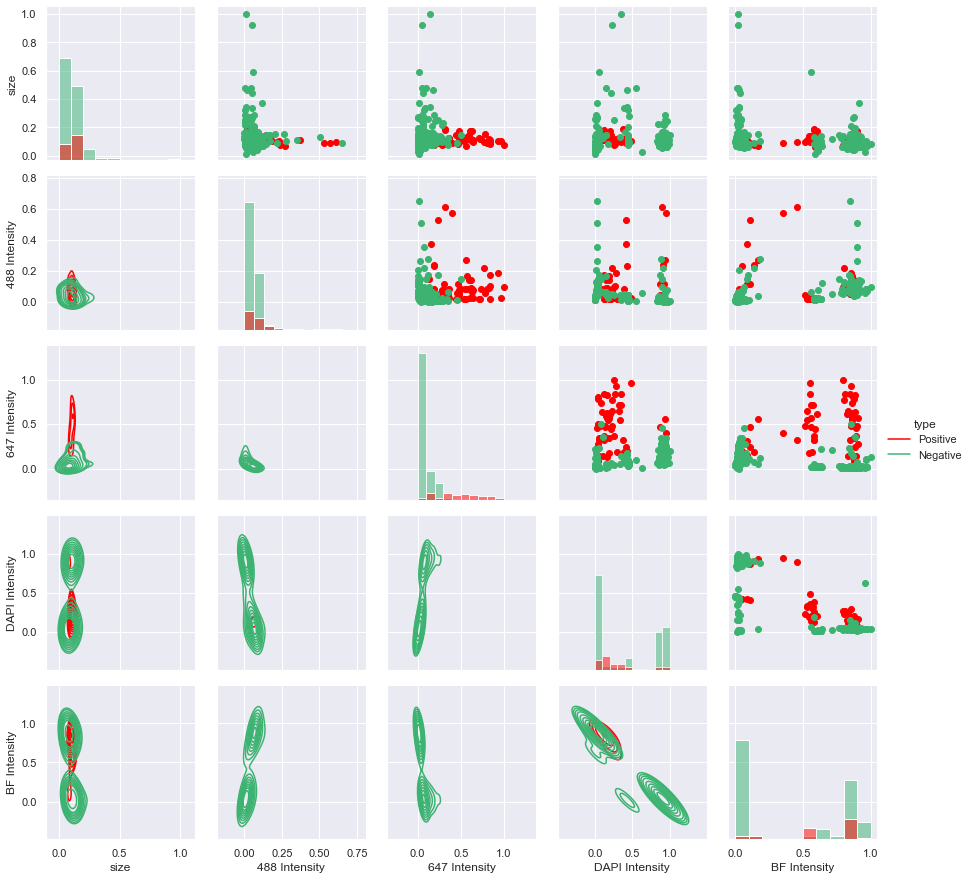

In [56]:
sns.set(style='darkgrid')

g = sns.PairGrid(df, hue='type', palette=['red', 'mediumseagreen'])
g.map_upper(plt.scatter)
g.map_lower(sns.kdeplot, thresh=.3, n_levels=10)
g.map_diag(sns.histplot, bins=10)
g.add_legend()

C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
C:\Users\Harrison\Anaconda3\lib\site-packages\seaborn\distributions.py:1678: UserWarning: `shade_lowest` is now deprecated in favor of `thresh`. Setting `thresh=0.3`, but please update your code.
  warnings.warn(msg, UserWarning)


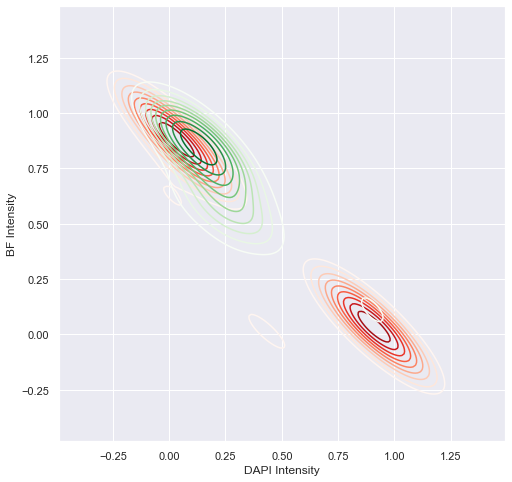

In [45]:
f, ax = plt.subplots(figsize=(8, 8))
# ax.set_aspect("equal")
df_p = df[df['type'] == 'Positive']
df_n = df[df['type'] == 'Negative']
ax = sns.kdeplot(df_n['DAPI Intensity'], df_n['BF Intensity'],
                 cmap="Reds", thresh=.3, shade=False)
ax = sns.kdeplot(df_p['DAPI Intensity'], df_p['BF Intensity'],
                 cmap="Greens", shade=False, thresh=.3, shade_lowest=False)

In [58]:
def hexbin(x, y, color, **kwargs):
    cmap = sns.light_palette(color, as_cmap=True)
    plt.hexbin(x, y, gridsize=15, cmap=cmap, **kwargs)
    
df_n.plot.hexbin(x=df_n['DAPI Intensity'], y=df_n['size'])

KeyError: "None of [Float64Index([ 0.44619115449185665,   0.4412688852521022,   0.4524885600532105,\n                0.4489398761991606,   0.4452687883329764,  0.45825221720197135,\n                0.4556122124308832,   0.4558177733925464,    0.443308024593983,\n               0.42436149211637053,\n              ...\n              0.020577207303005073, 0.016353555958590248,  0.03305273006171425,\n               0.04403365935979585,  0.07159111196907447,   0.6315618583133538,\n              0.025782609774309913, 0.028485280084562616,  0.05528464255408618,\n               0.11463284207848594],\n             dtype='float64', length=280)] are in the [columns]"